<a href="https://colab.research.google.com/github/RittiT2314/consumer-data-analysis/blob/main/pan_india_consumer_data.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Data Acquisition and Preprocessing

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pylab as plt
import seaborn as sns
plt.style.use('fivethirtyeight')
pd.set_option('display.max_columns', 200)
#pandas shows only few columns until mentioned otherwise, hence we set max columns

In [ ]:
df=pd.read_csv('/content/Augmented_IndiaTransactMultiFacet2024.csv')

In [ ]:
df.shape


(10267, 21)

In [ ]:
df.head(5)

,trans_id,trans_date_trans_time,cc_num,merchant,category,amt,first,last,gender,street,city,state,lat,long,city_pop,job,dob,merch_lat,merch_long,is_fraud,customer_id
0,295780.0,12-26-2023,5.800000e+11,fraud_Bedi-Krish Pvt Ltd,NaN,8552.65,Baiju,Sharma,F,"043, Lall Nagar, Dhule-732630",NaN,Rajasthan,-3.661078,145.222241,691077.0,"Surveyor, hydrographic",2-23-1993,-3.676868,145.213831,0.0,NaN
1,825718.0,07-07-2023,4.130000e+15,NaN,entertainment,9139.49,Bhavin,Roy,M,NaN,Rourkela,Meghalaya,NaN,-8.625930,NaN,Comptroller,10-20-1994,-14.437954,-8.607795,NaN,6.240000e+18
2,165012.0,4-25-2023,6.560000e+15,fraud_Hans-Kanda Pvt Ltd,entertainment,7568.37,Yuvraj,Madan,M,"04-41, Bawa Nagar, Khammam 816522",Jalna,Mizoram,76.196973,102.564244,380244.0,Probation officer,10-18-1963,76.214025,102.567219,0.0,-2.610000e+18
3,NaN,5-28-2023,3.530000e+15,NaN,entertainment,9074.00,Drishya,Bumb,F,"53-26, Chana Ganj, Varanasi 329560",Bharatpur,Chhattisgarh,27.840855,93.934433,440893.0,NaN,4-27-1996,27.838502,93.950223,0.0,2.190000e+18
4,742125.0,2-15-2023,4.800000e+12,"fraud_Agate, Varkey and Luthra Pvt Ltd",entertainment,5056.81,NaN,Lal,M,"43-32, Yohannan Zila, Udaipur-067444",Nizamabad,Jharkhand,81.974419,71.656847,308606.0,Chiropodist,1-19-1994,81.959219,71.668432,0.0,-5.210000e+18


In [ ]:
df.columns

Index(['trans_id', 'trans_date_trans_time', 'cc_num', 'merchant', 'category',
       'amt', 'first', 'last', 'gender', 'street', 'city', 'state', 'lat',
       'long', 'city_pop', 'job', 'dob', 'merch_lat', 'merch_long', 'is_fraud',
       'customer_id'],
      dtype='object')

In [ ]:
df.describe()

,trans_id,cc_num,amt,lat,long,city_pop,merch_lat,merch_long,is_fraud,customer_id
count,9618.000000,9.634000e+03,9516.000000,9516.000000,9526.000000,9510.000000,9628.000000,9349.000000,9622.000000,9.466000e+03
mean,549651.994905,4.603841e+17,5145.657144,1.922941,-0.471768,498632.899369,2.301703,-1.303246,0.524423,-1.252930e+17
std,262503.566896,1.358029e+18,2838.415208,51.437334,103.694747,280152.382801,51.366129,102.968532,0.499429,5.244562e+18
min,100342.000000,6.040180e+10,100.200000,-89.913914,-179.979360,1341.000000,-89.929070,-179.970597,0.000000,-9.210000e+18
25%,326747.000000,3.660000e+13,2756.657500,-41.347730,-90.794995,269405.000000,-39.447123,-90.885213,0.000000,-4.697500e+18
50%,561096.000000,3.500000e+15,5183.030000,4.025719,1.584318,502497.000000,4.421967,0.444523,1.000000,-1.665000e+16
75%,776482.000000,4.780000e+15,7596.260000,45.178250,89.251751,732504.500000,45.846092,87.717517,1.000000,4.350000e+18
max,998930.000000,4.990000e+18,9991.710000,89.609442,179.887230,999713.000000,89.590678,179.877529,1.000000,9.220000e+18


In [ ]:
df= df[[#'trans_id',
        'trans_date_trans_time', #'cc_num',
        'customer_id',
        #'merchant',
        'category',
       'amt', #'first', 'last',
        'gender', #'street',
        'city', 'state', 'lat','long',#'city_pop',
        'job',
        'dob', 'merch_lat', 'merch_long',
        'is_fraud']].copy()

In [ ]:
#remove null values from 'job'
df=df.dropna(subset=['job'])

In [ ]:
df.shape

(9351, 14)

In [ ]:
df.dtypes

,0
trans_date_trans_time,object
customer_id,float64
category,object
amt,float64
gender,object
city,object
state,object
lat,float64
long,float64
job,object


In [ ]:
df.isna().sum()

,0
trans_date_trans_time,787
customer_id,751
category,675
amt,682
gender,704
city,640
state,784
lat,675
long,631
job,0


In [ ]:
#we dont want duplicate in the data frame
df[df.duplicated()]

,trans_date_trans_time,customer_id,category,amt,gender,city,state,lat,long,job,dob,merch_lat,merch_long,is_fraud
1500,6-14-2022,7.420000e+18,fitness_and_medical,8817.31,F,Faridabad,Assam,72.501924,-28.707486,Passenger transport manager,3-22-1988,72.489787,-28.711848,0.0
1501,4-13-2024,NaN,online_shopping,5766.94,F,NaN,Tamil Nadu,-54.809309,-51.095182,Air traffic controller,09-11-1951,-54.791777,-51.105558,1.0
1502,12-03-2024,NaN,online_shopping,NaN,M,Jammu,Himachal Pradesh,-43.787082,-133.089948,Claims inspector-assessor,5-28-1970,-43.785700,-133.077020,NaN
1503,07-05-2022,3.240000e+18,fitness_and_medical,2714.89,M,Bokaro,Sikkim,51.742208,-18.060086,Adult guidance worker,2-17-1957,51.726438,-18.053950,0.0
1504,12-08-2023,NaN,travel,NaN,F,Ludhiana,Telangana,-32.180754,NaN,Archaeologist,8-21-1971,-32.186037,NaN,0.0
1505,8-21-2022,2.950000e+18,entertainment,4906.35,M,Proddatur,Telangana,-32.311903,87.256929,Geophysicist-field seismologist,1-26-2005,-32.301800,87.264305,1.0
1506,1-17-2024,1.880000e+18,travel,4579.20,F,Gandhidham,Uttar Pradesh,23.741273,NaN,Clothing-textile technologist,7-25-1964,23.748320,74.189686,1.0
1507,01-03-2023,-5.490000e+18,fitness_and_medical,303.59,F,Dindigul,Chhattisgarh,NaN,-144.799118,Psychiatric nurse,6-16-1988,71.342753,-144.803082,0.0
1508,6-18-2023,4.500000e+18,travel,1808.75,F,Kakinada,NaN,15.832526,-70.815475,Interior and spatial designer,11-12-1996,15.852074,-70.802459,1.0
1509,3-23-2023,-8.850000e+18,entertainment,6459.90,M,Gopalpur,Uttarakhand,45.178250,47.068601,Art gallery manager,2-17-1971,45.164603,47.066108,0.0


In [ ]:
df.loc[df.duplicated()]

,trans_date_trans_time,customer_id,category,amt,gender,city,state,lat,long,job,dob,merch_lat,merch_long,is_fraud
1500,6-14-2022,7.420000e+18,fitness_and_medical,8817.31,F,Faridabad,Assam,72.501924,-28.707486,Passenger transport manager,3-22-1988,72.489787,-28.711848,0.0
1501,4-13-2024,NaN,online_shopping,5766.94,F,NaN,Tamil Nadu,-54.809309,-51.095182,Air traffic controller,09-11-1951,-54.791777,-51.105558,1.0
1502,12-03-2024,NaN,online_shopping,NaN,M,Jammu,Himachal Pradesh,-43.787082,-133.089948,Claims inspector-assessor,5-28-1970,-43.785700,-133.077020,NaN
1503,07-05-2022,3.240000e+18,fitness_and_medical,2714.89,M,Bokaro,Sikkim,51.742208,-18.060086,Adult guidance worker,2-17-1957,51.726438,-18.053950,0.0
1504,12-08-2023,NaN,travel,NaN,F,Ludhiana,Telangana,-32.180754,NaN,Archaeologist,8-21-1971,-32.186037,NaN,0.0
1505,8-21-2022,2.950000e+18,entertainment,4906.35,M,Proddatur,Telangana,-32.311903,87.256929,Geophysicist-field seismologist,1-26-2005,-32.301800,87.264305,1.0
1506,1-17-2024,1.880000e+18,travel,4579.20,F,Gandhidham,Uttar Pradesh,23.741273,NaN,Clothing-textile technologist,7-25-1964,23.748320,74.189686,1.0
1507,01-03-2023,-5.490000e+18,fitness_and_medical,303.59,F,Dindigul,Chhattisgarh,NaN,-144.799118,Psychiatric nurse,6-16-1988,71.342753,-144.803082,0.0
1508,6-18-2023,4.500000e+18,travel,1808.75,F,Kakinada,NaN,15.832526,-70.815475,Interior and spatial designer,11-12-1996,15.852074,-70.802459,1.0
1509,3-23-2023,-8.850000e+18,entertainment,6459.90,M,Gopalpur,Uttarakhand,45.178250,47.068601,Art gallery manager,2-17-1971,45.164603,47.066108,0.0


In [ ]:
df['category'].isna()


,category
0,True
1,False
2,False
4,False
5,False
6,True
7,False
8,False
9,False
10,False


In [ ]:
missing_rows = df[df['category'].isna()]
print(missing_rows)


      trans_date_trans_time   customer_id category      amt gender  \
0                12-26-2023           NaN      NaN  8552.65      F   
6                02-03-2023 -3.350000e+18      NaN  7292.34      M   
53                4-15-2023  7.150000e+18      NaN  6827.46      F   
80               08-07-2023  6.120000e+17      NaN  4680.19      M   
96                7-14-2022 -5.580000e+18      NaN   896.17      F   
123              10-30-2023 -2.790000e+18      NaN  3994.42      M   
125              11-29-2022  3.250000e+18      NaN  2666.10      F   
131              12-17-2023 -2.100000e+18      NaN   246.60      F   
138              11-19-2022  2.090000e+18      NaN  8283.43      M   
156              06-03-2024  6.550000e+18      NaN  6171.54      F   
159              04-02-2023  2.850000e+18      NaN  5628.53      M   
160              02-03-2024  8.590000e+17      NaN  3980.61    NaN   
213              12-16-2023 -1.220000e+17      NaN   417.03      M   
215              02-

In [ ]:
df = df[~df['category'].isna()]
print(df)

      trans_date_trans_time   customer_id             category      amt  \
1                07-07-2023  6.240000e+18        entertainment  9139.49   
2                 4-25-2023 -2.610000e+18        entertainment  7568.37   
4                 2-15-2023 -5.210000e+18        entertainment  5056.81   
5                10-06-2023           NaN  fitness_and_medical   353.55   
7                10-06-2023  1.350000e+18  fitness_and_medical  8760.33   
8                03-06-2023 -3.070000e+18        entertainment  6729.28   
9                07-06-2023 -9.050000e+18               travel  8186.72   
10               01-04-2024  5.300000e+17      online_shopping   200.08   
11               10-21-2023  3.770000e+18               travel  9211.65   
12               12-15-2022  4.020000e+18      online_shopping  9776.22   
13               04-04-2023 -2.520000e+18  fitness_and_medical  9182.83   
14               10-26-2022           NaN        entertainment  4333.70   
16                4-18-20

In [ ]:
df.shape

(8676, 14)

In [ ]:
df.columns

Index(['trans_date_trans_time', 'customer_id', 'category', 'amt', 'gender',
       'city', 'state', 'lat', 'long', 'job', 'dob', 'merch_lat', 'merch_long',
       'is_fraud'],
      dtype='object')

In [ ]:
df_state = df[['city', 'state']]
df_state = df_state[(df_state['city'].notna())]

display(df_state)

,city,state
1,Rourkela,Meghalaya
2,Jalna,Mizoram
4,Nizamabad,Jharkhand
5,Bahraich,Karnataka
7,Bokaro,Meghalaya
8,Gwalior,Telangana
9,Rampur,Uttarakhand
11,Udaipur,Andhra Pradesh
12,Malda,Nagaland
16,Pallavaram,Sikkim


In [ ]:
df['amt'].isna().sum()

655

In [ ]:
missing_rows=df[df['amt'].isna()]
print(missing_rows)

      trans_date_trans_time   customer_id             category  amt gender  \
18                4-29-2022 -1.480000e+16        entertainment  NaN      F   
45               03-10-2022           NaN        entertainment  NaN      F   
87                5-29-2022 -3.520000e+18      online_shopping  NaN    NaN   
90               03-07-2023 -6.180000e+18      online_shopping  NaN      M   
108                     NaN -9.560000e+17               travel  NaN      F   
118               4-29-2022  1.710000e+18      online_shopping  NaN      M   
153               7-15-2023           NaN               travel  NaN      M   
163              04-04-2024 -6.100000e+18      online_shopping  NaN      M   
166              10-19-2022  2.360000e+18        entertainment  NaN      M   
179               9-26-2023  7.240000e+18               travel  NaN      M   
199               4-18-2023 -6.800000e+18        entertainment  NaN      M   
210                     NaN  3.250000e+18        entertainment  

In [ ]:
df=df[~df['amt'].isna()]

In [ ]:
df.shape

(8021, 14)

In [ ]:
df['amt'].isna().sum()

0

In [ ]:
df= df[~df['trans_date_trans_time'].isna()]
df.shape

(7341, 14)

In [ ]:
df['trans_date_trans_time'].isna().sum()

0

In [ ]:
df['dob'].isna().sum()
df=df[~df['dob'].isna()]
df['dob'].isna().sum()


0

In [ ]:
df.shape

(6738, 14)

In [ ]:
df[['lat', 'long']].isna().sum()

,0
lat,462
long,519


In [ ]:
df = df.dropna(subset=['lat', 'long'])
df[['lat', 'long']].isna().sum()


,0
lat,0
long,0


In [ ]:
df[['merch_lat', 'merch_long']].isna().sum()
df=df.dropna(subset=['merch_lat','merch_long'])
df[['merch_lat', 'merch_long']].isna().sum()

,0
merch_lat,0
merch_long,0


In [ ]:
df['is_fraud'].isna().sum()
df=df.dropna(subset=['is_fraud'])
df['is_fraud'].isna().sum()

0

In [ ]:
df.shape

(4719, 14)

In [ ]:
df.columns

Index(['trans_date_trans_time', 'customer_id', 'category', 'amt', 'gender',
       'city', 'state', 'lat', 'long', 'job', 'dob', 'merch_lat', 'merch_long',
       'is_fraud'],
      dtype='object')

In [ ]:
#drop null values from city columns
df=df.dropna(subset=['city'])

In [ ]:
#check null values in state
df['state'].isna().sum()

333

In [ ]:
df['city'] = df['city'].str.strip().str.title()

In [ ]:
# Read list_of_cities_and_towns_in_india-834j.csv file into a pandas dataframe
cities_df = pd.read_csv('/content/list_of_cities_and_towns_in_india-834j.csv')

cities_df.head()

,S.No,Name of City,State,Type,Population (2011),Population class,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,Unnamed: 10
0,1,Mumbai,Maharashtra,Municipal Corporation / Corporation,"1,35,97,924",Class I,NaN,NaN,NaN,NaN,NaN
1,2,Delhi,Delhi,Municipal Corporation / Corporation,"1,10,07,835",Class I,NaN,NaN,NaN,NaN,NaN
2,3,Bengaluru,Karnataka,Municipal Corporation / Corporation,"84,25,970",Class I,NaN,NaN,NaN,NaN,NaN
3,4,Ahmedabad,Gujarat,Municipal Corporation / Corporation.,"72,08,200",Class I,NaN,NaN,NaN,NaN,NaN
4,5,Hyderabad,Telangana,Municipal Corporation / Corporation,"68,09,970",Class I,NaN,NaN,NaN,NaN,NaN


In [ ]:
# Create a dictionary with (key, value) pairs as (city, state) from the cities_df dataframe
city_state_dict = dict(zip(cities_df['Name of City'], cities_df['State']))

In [ ]:
# Run through all the null values in the state column of df and enter the state according to the corresponding city using city_state_dict, if the city is not present then drop the row having null value in the state column
for index, row in df[df['state'].isna()].iterrows():
    city = row['city']
    if city in city_state_dict:
        df.at[index, 'state'] = city_state_dict[city]
    else:
        df.drop(index, inplace=True)

In [ ]:
# Check for null values in the state column
df['state'].isna().sum()

0

In [ ]:
df.shape

(4274, 14)

In [ ]:
# drop 'city' column
df = df.drop('city', axis=1)

In [ ]:
#drop null values from gender
df=df.dropna(subset=['gender'])
#drop null values from 'job'


In [ ]:
df.shape

(3877, 13)

In [ ]:
df.columns

Index(['trans_date_trans_time', 'customer_id', 'category', 'amt', 'gender',
       'state', 'lat', 'long', 'job', 'dob', 'merch_lat', 'merch_long',
       'is_fraud'],
      dtype='object')

In [ ]:
#check all null values in data set
df.isna().sum()

,0
trans_date_trans_time,0
customer_id,256
category,0
amt,0
gender,0
state,0
lat,0
long,0
job,0
dob,0


In [ ]:
df['customer_id'].nunique()

470

In [ ]:
df.shape

(3877, 13)

In [ ]:
# Drop customer_id column
df = df.drop('customer_id', axis=1)

In [ ]:
print(df.shape)
print(df.isna().sum())

(3877, 12)
trans_date_trans_time    0
category                 0
amt                      0
gender                   0
state                    0
lat                      0
long                     0
job                      0
dob                      0
merch_lat                0
merch_long               0
is_fraud                 0
dtype: int64


In [ ]:
df.columns
df.shape

(3877, 12)

## Data Analysis

In [ ]:
#unique category
df['category'].unique()

array(['entertainment', 'fitness_and_medical', 'travel',
       'online_shopping'], dtype=object)

In [ ]:
#calculate average spending on each category with 'amt' column
df.groupby('category')['amt'].mean()

,amt
category,
entertainment,4900.258045
fitness_and_medical,4907.686558
online_shopping,5089.072486
travel,5378.942906


In [ ]:
#Analyze relationship between amt and category
category_df = df[['category', 'amt']]
# Calculate the average spending per category
category_avg = category_df.groupby('category', as_index=False)['amt'].mean()
category_avg.rename(columns={'amt': 'average_amt'}, inplace=True)
# Sort the categories by average spending for better visualization
category_avg.sort_values(by='average_amt', ascending=False, inplace=True)
#check the average values
print(category_avg)




              category  average_amt
3               travel  5378.942906
2      online_shopping  5089.072486
1  fitness_and_medical  4907.686558
0        entertainment  4900.258045


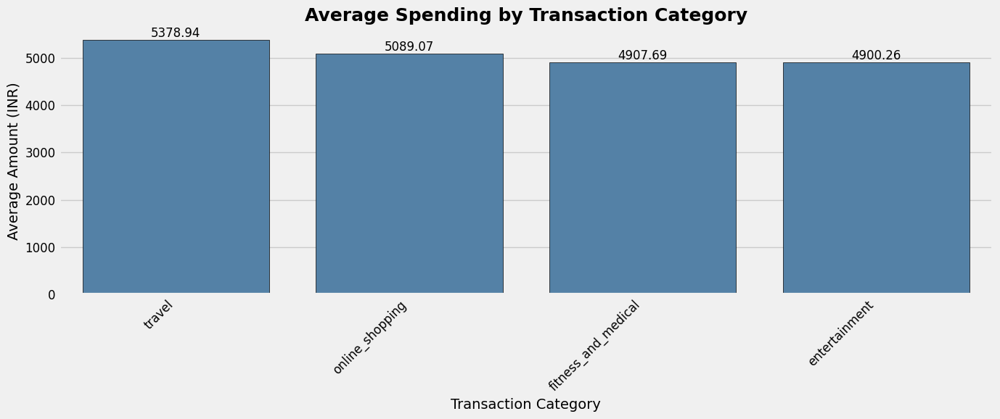

In [ ]:
# Create the bar plot
plt.figure(figsize=(14, 6))  # Adjust figure size
sns.barplot(data=category_avg, x='category', y='average_amt',color='steelblue', edgecolor='black')

# Customize the plot
plt.title('Average Spending by Transaction Category', fontsize=18, weight='bold')
plt.xlabel('Transaction Category', fontsize=14)
plt.ylabel('Average Amount (INR)', fontsize=14)
plt.yticks(fontsize=12)
plt.xticks(rotation=45, ha='right', fontsize=12)  # Rotate category labels for better readability
plt.tight_layout()  # Adjust layout to prevent overlapping
#Annotate the bar graph
for i, v in enumerate(category_avg['average_amt']):
    plt.text(i, v, str(round(v, 2)), ha='center', va='bottom', fontsize=12)



plt.show()


In [ ]:
df.columns

Index(['trans_date_trans_time', 'category', 'amt', 'gender', 'state', 'lat',
       'long', 'job', 'dob', 'merch_lat', 'merch_long', 'is_fraud'],
      dtype='object')

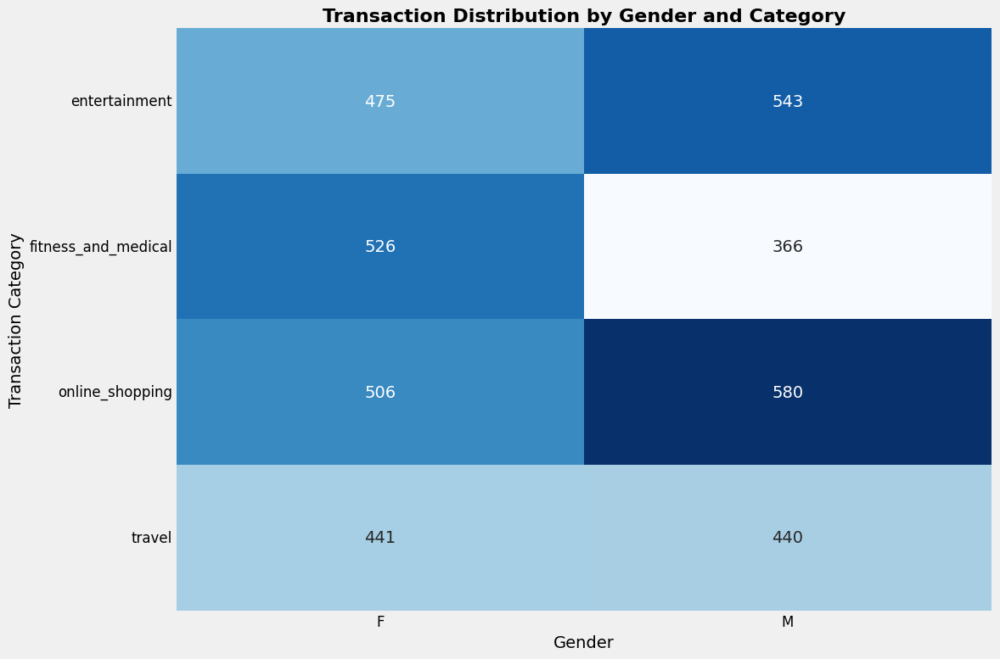

In [ ]:
#Create a pivot table or cross-tabulation for Gender and Category
gender_category_pivot = pd.crosstab(df['category'], df['gender'])
#Create a pivot table or cross-tabulation for Gender and Category (percentage-wise)
gender_category_percentage = pd.crosstab(df['category'], df['gender'], normalize='index')*100

# Visualization: Heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(gender_category_pivot, annot=True, fmt='d', cmap='Blues', cbar=False)


# Customizing the plot
plt.title('Transaction Distribution by Gender and Category', fontsize=16, weight='bold')
plt.xlabel('Gender', fontsize=14)
plt.ylabel('Transaction Category', fontsize=14)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12, rotation=0)
plt.tight_layout()
plt.show()


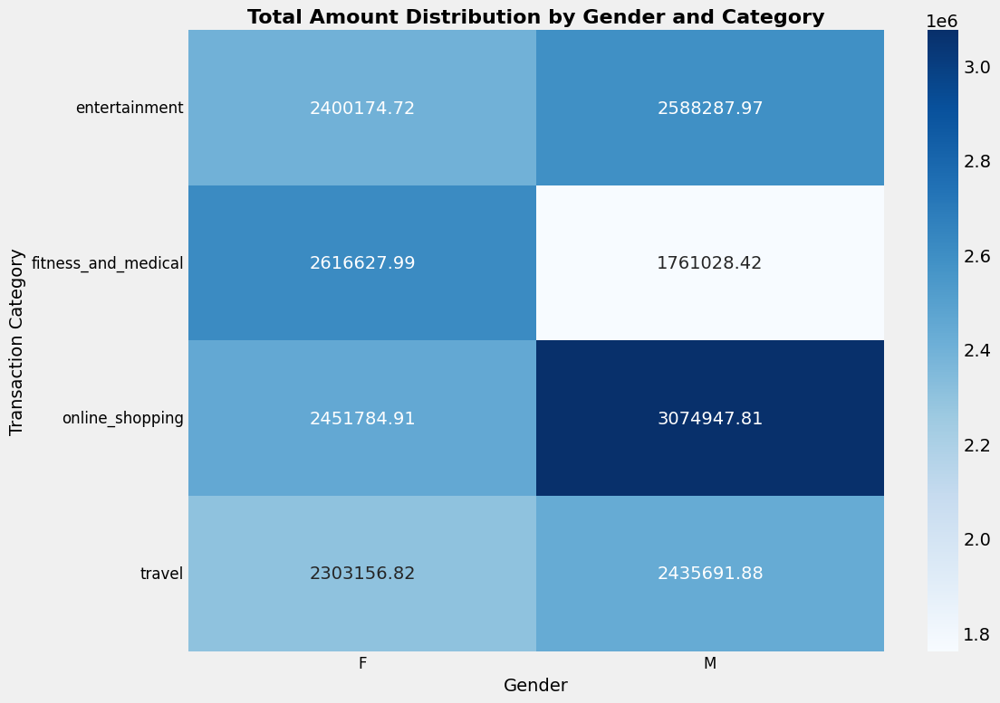

In [ ]:
# Pivot table: Total amount distributed by gender and category
gender_category_amt = df.pivot_table(values='amt', index='category', columns='gender', aggfunc='sum', fill_value=0)

# Visualization: Heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(gender_category_amt, annot=True, fmt='.2f', cmap='Blues', cbar=True)

# Customizing the plot
plt.title('Total Amount Distribution by Gender and Category', fontsize=16, weight='bold')
plt.xlabel('Gender', fontsize=14)
plt.ylabel('Transaction Category', fontsize=14)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12, rotation=0)
plt.tight_layout()
plt.show()

In [ ]:
# Group by 'category' and 'gender' to calculate total, average, and count of transactions
analysis = df.groupby(['category', 'gender']).agg(
    total_amt=('amt', 'sum'),     # Total transaction amount
    avg_amt=('amt', 'mean'),      # Average transaction amount
    transaction_count=('amt', 'count')  # Total number of transactions
).reset_index()

# Sort the results for better readability
analysis = analysis.sort_values(by=['category', 'gender'])

# Analyze the results
print("Analysis of Transactions by Category and Gender:")
print(analysis)

# Additional Summary Statistics
overall_summary = df.groupby('gender')['amt'].agg(
    total_amt='sum',
    avg_amt='mean',
    max_amt='max',
    min_amt='min',
    transaction_count='count'
).reset_index()

print("\nOverall Summary by Gender:")
print(overall_summary)

category_summary = df.groupby('category')['amt'].agg(
    total_amt='sum',
    avg_amt='mean',
    max_amt='max',
    min_amt='min',
    transaction_count='count'
).reset_index()

print("\nOverall Summary by Category:")
print(category_summary)


Analysis of Transactions by Category and Gender:
              category gender   total_amt      avg_amt  transaction_count
0        entertainment      F  2400174.72  5052.999411                475
1        entertainment      M  2588287.97  4766.644512                543
2  fitness_and_medical      F  2616627.99  4974.577928                526
3  fitness_and_medical      M  1761028.42  4811.553060                366
4      online_shopping      F  2451784.91  4845.424723                506
5      online_shopping      M  3074947.81  5301.634155                580
6               travel      F  2303156.82  5222.577823                441
7               travel      M  2435691.88  5535.663364                440

Overall Summary by Gender:
  gender   total_amt      avg_amt  max_amt  min_amt  transaction_count
0      F  9771744.44  5016.295914  9991.71   162.91               1948
1      M  9859956.08  5111.433945  9980.29   130.72               1929

Overall Summary by Category:
              

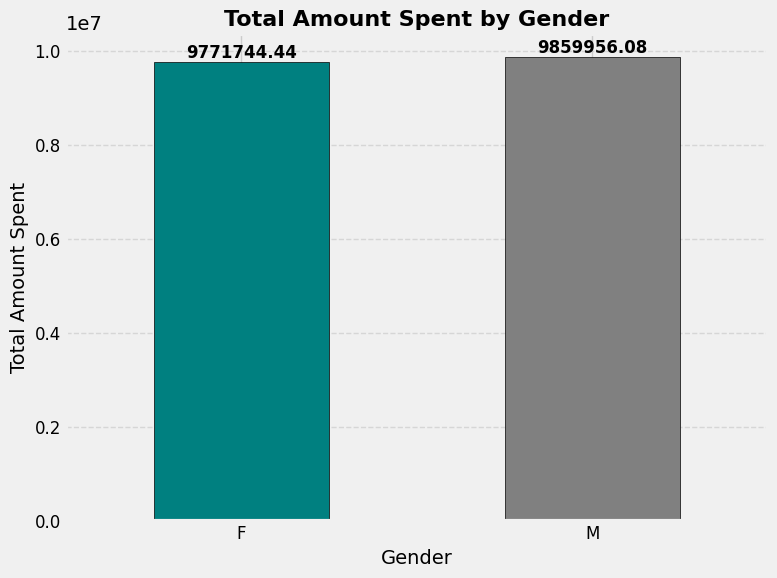

In [ ]:
# Group by gender and calculate the total amount spent
gender_amount = df.groupby('gender')['amt'].sum()

# Plot the bar graph
plt.figure(figsize=(8, 6))
ax = gender_amount.plot(kind='bar', color=['teal', 'gray'], edgecolor='black')

# Customizing the plot
plt.title('Total Amount Spent by Gender', fontsize=16, weight='bold')
plt.xlabel('Gender', fontsize=14)
plt.ylabel('Total Amount Spent', fontsize=14)
plt.xticks(fontsize=12, rotation=0)
plt.yticks(fontsize=12)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()

# Annotating the bars with the total amount spent
for i, total in enumerate(gender_amount):
    plt.text(i, total, f'{total:.2f}', ha='center', va='bottom', fontsize=12, weight='bold')

# Display the bar graph
plt.show()


In [ ]:
#total number of male and female
df['gender'].value_counts()

,count
gender,
F,1948
M,1929


In [ ]:
#distribution of gender in category
df.groupby('category')['gender'].value_counts()

category             gender
entertainment        M         543
                     F         475
fitness_and_medical  F         526
                     M         366
online_shopping      M         580
                     F         506
travel               F         441
                     M         440
Name: count, dtype: int64

In [ ]:
#amt spent on each category by each gender
df.groupby(['category', 'gender'])['amt'].sum()

category             gender
entertainment        F         2400174.72
                     M         2588287.97
fitness_and_medical  F         2616627.99
                     M         1761028.42
online_shopping      F         2451784.91
                     M         3074947.81
travel               F         2303156.82
                     M         2435691.88
Name: amt, dtype: float64

In [ ]:
#null values in dob column
df['dob'].isna().sum()

0

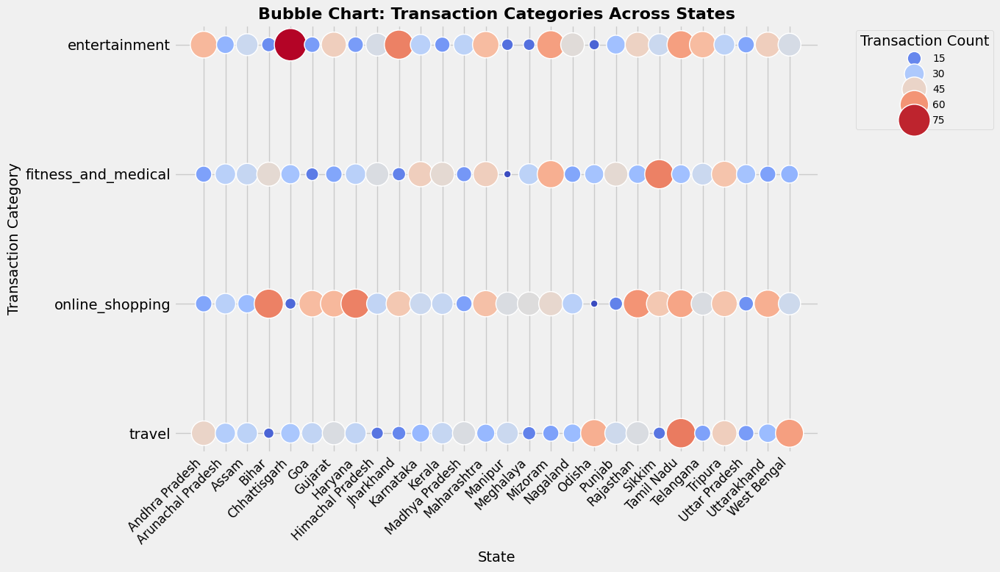

In [ ]:
# Group data by State and Category, and count occurrences
category_state_counts = df.groupby(['state', 'category']).size().reset_index(name='count')

# Visualization: Bubble Chart
plt.figure(figsize=(14, 8))
sns.scatterplot(
    data=category_state_counts,
    x='state', y='category', size='count', sizes=(50, 1000), hue='count', palette='coolwarm'
)

# Customizing the plot
plt.title('Bubble Chart: Transaction Categories Across States', fontsize=16, weight='bold')
plt.xlabel('State', fontsize=14)
plt.ylabel('Transaction Category', fontsize=14)
plt.xticks(rotation=45, ha='right', fontsize=12)
plt.legend(title='Transaction Count', bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=10)
plt.tight_layout()
plt.show()

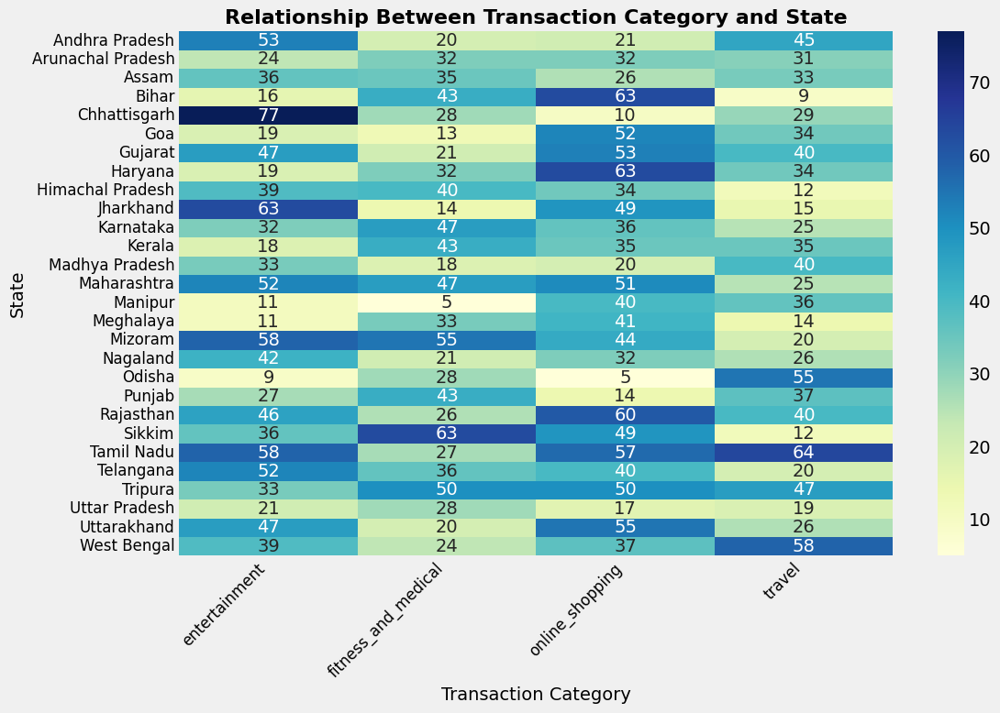

In [ ]:
category_state_counts = df.pivot_table(index='state', columns='category', aggfunc='size', fill_value=0)

# Visualization: Heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(category_state_counts, cmap='YlGnBu', annot=True, fmt='d', cbar=True)

# Customizing the heatmap
plt.title('Relationship Between Transaction Category and State', fontsize=16, weight='bold')
plt.xlabel('Transaction Category', fontsize=14)
plt.ylabel('State', fontsize=14)
plt.xticks(rotation=45, ha='right', fontsize=12)
plt.yticks(fontsize=12)
plt.tight_layout()
plt.show()

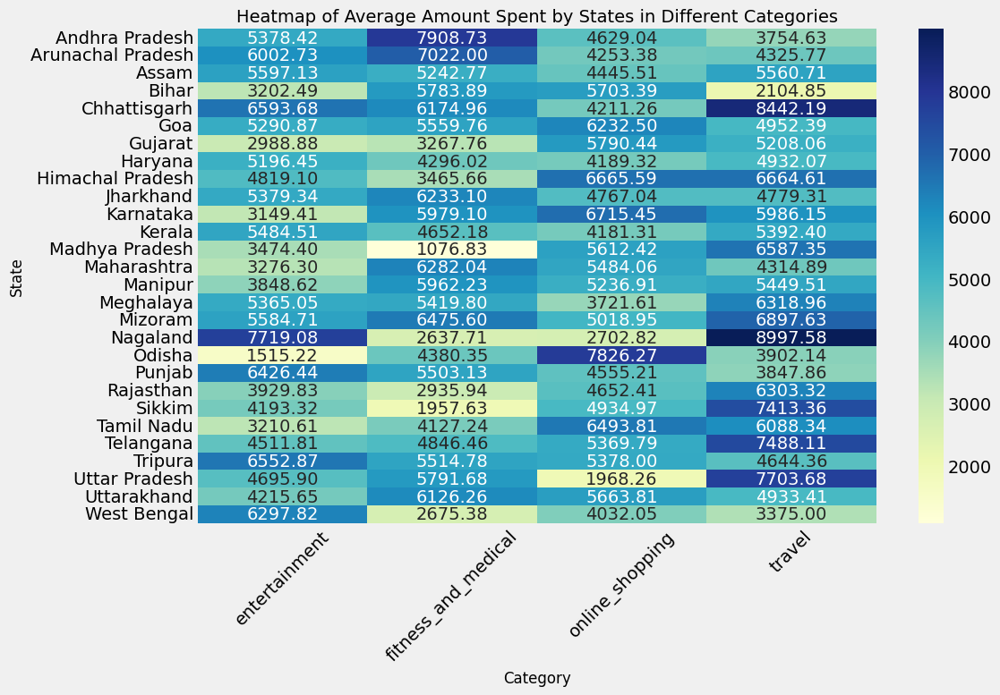

In [ ]:
# Pivot the data to create a matrix for the heatmap
heatmap_df = df.pivot_table(
    index="state", columns="category", values="amt", aggfunc="mean"
)

# Plot the heatmap
plt.figure(figsize=(12, 8))  # Adjust the figure size as needed
sns.heatmap(heatmap_df, annot=True, fmt=".2f", cmap="YlGnBu", cbar=True)

# Customize the plot
plt.title("Heatmap of Average Amount Spent by States in Different Categories", fontsize=14)
plt.xlabel("Category", fontsize=12)
plt.ylabel("State", fontsize=12)
plt.xticks(rotation=45)
plt.tight_layout()

# Show the plot
plt.show()


In [ ]:
# Grouping data by state and category to compute transaction counts
category_state_counts = df.groupby(['state', 'category']).size().reset_index(name='transaction_count')

# Aggregating data to find state-wise and category-wise total counts
state_summary = category_state_counts.groupby('state')['transaction_count'].sum().reset_index(name='total_transactions_by_state')
category_summary = category_state_counts.groupby('category')['transaction_count'].sum().reset_index(name='total_transactions_by_category')

# Merging summaries for detailed insights
state_category_analysis = category_state_counts.merge(state_summary, on='state').merge(category_summary, on='category')

# Calculating proportions
state_category_analysis['state_percentage'] = (state_category_analysis['transaction_count'] / state_category_analysis['total_transactions_by_state']) * 100
state_category_analysis['category_percentage'] = (state_category_analysis['transaction_count'] / state_category_analysis['total_transactions_by_category']) * 100

# Display the results
print("Detailed Analysis of Transactions by State and Category:")
print(state_category_analysis)
#show all the data
pd.set_option('display.max_rows', None)


Detailed Analysis of Transactions by State and Category:
                 state             category  transaction_count  \
0       Andhra Pradesh        entertainment                 53   
1       Andhra Pradesh  fitness_and_medical                 20   
2       Andhra Pradesh      online_shopping                 21   
3       Andhra Pradesh               travel                 45   
4    Arunachal Pradesh        entertainment                 24   
5    Arunachal Pradesh  fitness_and_medical                 32   
6    Arunachal Pradesh      online_shopping                 32   
7    Arunachal Pradesh               travel                 31   
8                Assam        entertainment                 36   
9                Assam  fitness_and_medical                 35   
10               Assam      online_shopping                 26   
11               Assam               travel                 33   
12               Bihar        entertainment                 16   
13               Bi

In [ ]:
df.columns

Index(['trans_date_trans_time', 'category', 'amt', 'gender', 'state', 'lat',
       'long', 'job', 'dob', 'merch_lat', 'merch_long', 'is_fraud'],
      dtype='object')

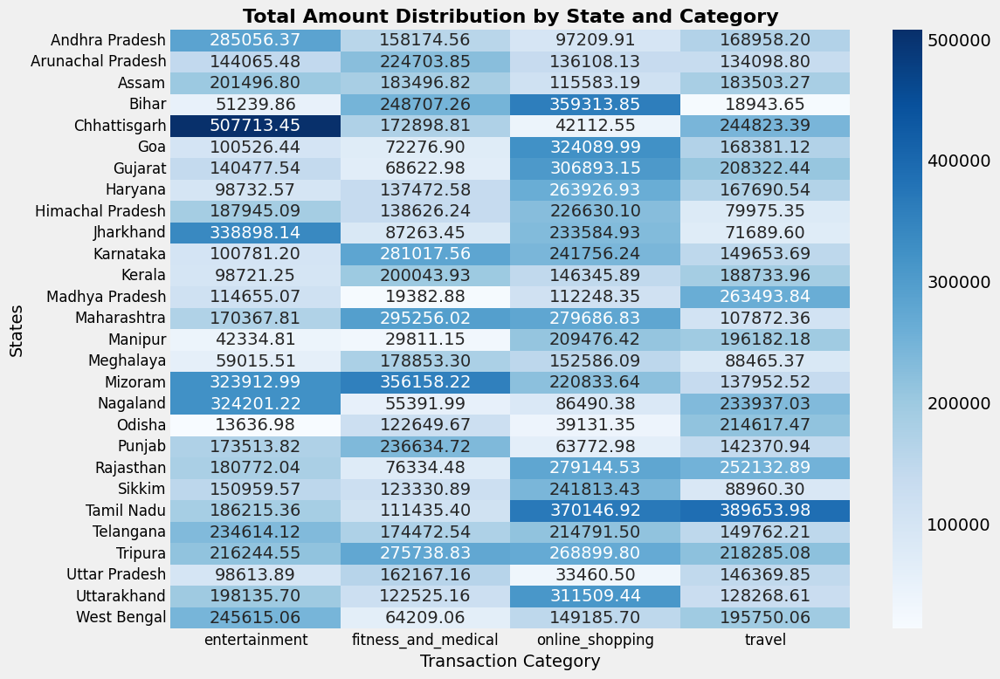

In [ ]:
# Pivot table: Total amount distributed by state and category
gender_category_amt = df.pivot_table(values='amt', index='state', columns='category', aggfunc='sum', fill_value=0)

# Visualization: Heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(gender_category_amt, annot=True, fmt='.2f', cmap='Blues', cbar=True)

# Customizing the plot
plt.title('Total Amount Distribution by State and Category', fontsize=16, weight='bold')
plt.xlabel('Transaction Category', fontsize=14)
plt.ylabel('States', fontsize=14)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12, rotation=0)
plt.tight_layout()
plt.show()

In [ ]:
# Group by 'category' and 'gender' to calculate total, average, and count of transactions
analysis = df.groupby(['category', 'state']).agg(
    total_amt=('amt', 'sum'),     # Total transaction amount
    avg_amt=('amt', 'mean'),      # Average transaction amount
    transaction_count=('amt', 'count')  # Total number of transactions
).reset_index()

#  Sort the results for better readability
analysis = analysis.sort_values(by=['category', 'state'])

#  Analyze the results
print("Analysis of Transactions by Category and State:")
print(analysis)

# Additional Summary Statistics (optional)
overall_summary = df.groupby('state')['amt'].agg(
    total_amt='sum',
    avg_amt='mean',
    max_amt='max',
    min_amt='min',
    transaction_count='count'
).reset_index()

print("\nOverall Summary by State:")
print(overall_summary)

category_summary = df.groupby('category')['amt'].agg(
    total_amt='sum',
    avg_amt='mean',
    max_amt='max',
    min_amt='min',
    transaction_count='count'
).reset_index()

print("\nOverall Summary by Category:")
print(category_summary)

Analysis of Transactions by Category and State:
                category              state  total_amt      avg_amt  \
0          entertainment     Andhra Pradesh  285056.37  5378.422075   
1          entertainment  Arunachal Pradesh  144065.48  6002.728333   
2          entertainment              Assam  201496.80  5597.133333   
3          entertainment              Bihar   51239.86  3202.491250   
4          entertainment       Chhattisgarh  507713.45  6593.681169   
5          entertainment                Goa  100526.44  5290.865263   
6          entertainment            Gujarat  140477.54  2988.883830   
7          entertainment            Haryana   98732.57  5196.451053   
8          entertainment   Himachal Pradesh  187945.09  4819.104872   
9          entertainment          Jharkhand  338898.14  5379.335556   
10         entertainment          Karnataka  100781.20  3149.412500   
11         entertainment             Kerala   98721.25  5484.513889   
12         entertainment     

In [ ]:
#distribution of 'state' in 'category'
df.groupby('category')['state'].value_counts()

category             state            
entertainment        Chhattisgarh         77
                     Jharkhand            63
                     Mizoram              58
                     Tamil Nadu           58
                     Andhra Pradesh       53
                     Maharashtra          52
                     Telangana            52
                     Gujarat              47
                     Uttarakhand          47
                     Rajasthan            46
                     Nagaland             42
                     Himachal Pradesh     39
                     West Bengal          39
                     Assam                36
                     Sikkim               36
                     Madhya Pradesh       33
                     Tripura              33
                     Karnataka            32
                     Punjab               27
                     Arunachal Pradesh    24
                     Uttar Pradesh        21
                     Goa                  19
                     Haryana              19
                     Kerala               18
                     Bihar                16
                     Manipur              11
                     Meghalaya            11
                     Odisha                9
fitness_and_medical  Sikkim               63
                     Mizoram              55
                     Tripura              50
                     Karnataka            47
                     Maharashtra          47
                     Bihar                43
                     Kerala               43
                     Punjab               43
                     Himachal Pradesh     40
                     Telangana            36
                     Assam                35
                     Meghalaya            33
                     Arunachal Pradesh    32
                     Haryana              32
                     Chhattisgarh         28
                     Odisha               28
                     Uttar Pradesh        28
                     Tamil Nadu           27
                     Rajasthan            26
                     West Bengal          24
                     Gujarat              21
                     Nagaland             21
                     Andhra Pradesh       20
                     Uttarakhand          20
                     Madhya Pradesh       18
                     Jharkhand            14
                     Goa                  13
                     Manipur               5
online_shopping      Bihar                63
                     Haryana              63
                     Rajasthan            60
                     Tamil Nadu           57
                     Uttarakhand          55
                     Gujarat              53
                     Goa                  52
                     Maharashtra          51
                     Tripura              50
                     Jharkhand            49
                     Sikkim               49
                     Mizoram              44
                     Meghalaya            41
                     Manipur              40
                     Telangana            40
                     West Bengal          37
                     Karnataka            36
                     Kerala               35
                     Himachal Pradesh     34
                     Arunachal Pradesh    32
                     Nagaland             32
                     Assam                26
                     Andhra Pradesh       21
                     Madhya Pradesh       20
                     Uttar Pradesh        17
                     Punjab               14
                     Chhattisgarh         10
                     Odisha                5
travel               Tamil Nadu           64
                     West Bengal          58
                     Odisha               55
                     Tripura              47
 

In [ ]:
from datetime import datetime

# Convert the 'dob' column to datetime (assuming MM-DD-YYYY format)
# The errors='coerce' will convert invalid dates to NaT (Not a Time)
df['dob'] = pd.to_datetime(df['dob'], format='%m-%d-%Y', errors='coerce')

# Calculate age
def calculate_age(dob):
    """Calculate age from date of birth."""
    if pd.isna(dob):  # Handle missing or invalid dates
        return None
    today = datetime.today()
    return today.year - dob.year - ((today.month, today.day) < (dob.month, dob.day))

df['age'] = df['dob'].apply(calculate_age)

# Now we can format the 'dob' column to string with the desired format
# This is done after age calculation to avoid issues with invalid dates
df['dob'] = df['dob'].dt.strftime('%m-%d-%Y')

# Handle remaining NaT values after formatting
df['dob'].fillna('Invalid Date', inplace=True)  # Replace NaT with 'Invalid Date'

# View the result
print(df[['dob', 'age']].head())

           dob  age
2   10-18-1963   61
4   01-19-1994   30
7   07-21-2000   24
16  11-02-2005   19
21  07-03-1953   71


<ipython-input-252-d57637a5fccf>:23: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df['dob'].fillna('Invalid Date', inplace=True)  # Replace NaT with 'Invalid Date'


In [ ]:


# Convert the 'dob' column to datetime (assuming MM-DD-YYYY format)
df['dob'] = pd.to_datetime(df['dob'], format='%m-%d-%Y', errors='coerce')  # Errors will become NaT for invalid dates

# Calculate age
def calculate_age(dob):
    """Calculate age from date of birth."""
    if pd.isna(dob):  # Handle missing or invalid dates
        return None
    today = datetime.today()
    return today.year - dob.year - ((today.month, today.day) < (dob.month, dob.day))

df['age'] = df['dob'].apply(calculate_age)

# Save or view the updated data
# Print the first few rows to verify
print(df[['dob', 'age']].head())



          dob  age
2  1963-10-18   61
4  1994-01-19   30
7  2000-07-21   24
16 2005-11-02   19
21 1953-07-03   71


In [ ]:
# check null values in age column
df['age'].isna().sum()

0

In [ ]:
df.shape

(3877, 13)

In [ ]:
df.columns

Index(['trans_date_trans_time', 'category', 'amt', 'gender', 'state', 'lat',
       'long', 'job', 'dob', 'merch_lat', 'merch_long', 'is_fraud', 'age'],
      dtype='object')

In [ ]:
df.head()

,trans_date_trans_time,category,amt,gender,state,lat,long,job,dob,merch_lat,merch_long,is_fraud,age
2,4-25-2023,entertainment,7568.37,M,Mizoram,76.196973,102.564244,Probation officer,1963-10-18,76.214025,102.567219,0.0,61
4,2-15-2023,entertainment,5056.81,M,Jharkhand,81.974419,71.656847,Chiropodist,1994-01-19,81.959219,71.668432,0.0,30
7,10-06-2023,fitness_and_medical,8760.33,F,Meghalaya,10.800613,128.719889,"Therapist, drama",2000-07-21,10.786513,128.737108,0.0,24
16,4-18-2023,fitness_and_medical,542.89,M,Sikkim,28.890278,11.340253,"Conservator, museum-gallery",2005-11-02,28.897518,11.358012,1.0,19
21,6-29-2023,entertainment,8250.53,F,Jharkhand,86.625582,-43.427319,"Designer, furniture",1953-07-03,86.610597,-43.420373,1.0,71


In [ ]:
age_range = df['age'].max() - df['age'].min()
print(f"The range of ages in the dataset is: {age_range}")

The range of ages in the dataset is: 68


In [ ]:
minimum_age = df['age'].min()
maximum_age = df['age'].max()

print(f"Minimum age: {minimum_age}")
print(f"Maximum age: {maximum_age}")

Minimum age: 18
Maximum age: 86


In [ ]:
df['age'].isnull().sum()

0

In [ ]:
# Categorize age into bins
bins = [18, 24, 34, 44, 64, 84]  # Define the boundaries of the age groups
labels = ['Youth (18-24)', 'Early Adulthood (25-34)', 'Early Middle Age (35-44)', 'Late Middle Age (45-64)', 'Late Adulthood (65-86)']  # Labels for each age group

# Add the new age_group column
df['age_group'] = pd.cut(df['age'], bins=bins, labels=labels, right=True)

# Check the resulting DataFrame
print(df[['age', 'age_group']].head())


    age                age_group
2    61  Late Middle Age (45-64)
4    30  Early Adulthood (25-34)
7    24            Youth (18-24)
16   19            Youth (18-24)
21   71   Late Adulthood (65-86)


In [ ]:
# check null values for age group column
df['age_group'].isna().sum()

115

In [ ]:
df.head(5)

,trans_date_trans_time,category,amt,gender,state,lat,long,job,dob,merch_lat,merch_long,is_fraud,age,age_group
2,4-25-2023,entertainment,7568.37,M,Mizoram,76.196973,102.564244,Probation officer,1963-10-18,76.214025,102.567219,0.0,61,Late Middle Age (45-64)
4,2-15-2023,entertainment,5056.81,M,Jharkhand,81.974419,71.656847,Chiropodist,1994-01-19,81.959219,71.668432,0.0,30,Early Adulthood (25-34)
7,10-06-2023,fitness_and_medical,8760.33,F,Meghalaya,10.800613,128.719889,"Therapist, drama",2000-07-21,10.786513,128.737108,0.0,24,Youth (18-24)
16,4-18-2023,fitness_and_medical,542.89,M,Sikkim,28.890278,11.340253,"Conservator, museum-gallery",2005-11-02,28.897518,11.358012,1.0,19,Youth (18-24)
21,6-29-2023,entertainment,8250.53,F,Jharkhand,86.625582,-43.427319,"Designer, furniture",1953-07-03,86.610597,-43.420373,1.0,71,Late Adulthood (65-86)


In [ ]:
# Categorize age into bins
bins = [17, 24, 34, 44, 54, 64, 86]  # Define the boundaries of the age groups
labels = ['Category 1 (18-24)', 'Category 2 (25-34)', 'Category 3 (35-44)', 'Category 4 (45-54)', 'Category 5 (55-64)', 'Category 6 (65-84)']  # Labels for each age group

# Add the new age_group column
df['age_group'] = pd.cut(df['age'], bins=bins, labels=labels, right=True)

# Check the resulting DataFrame
print(df[['age', 'age_group']].head())

    age           age_group
2    61  Category 5 (55-64)
4    30  Category 2 (25-34)
7    24  Category 1 (18-24)
16   19  Category 1 (18-24)
21   71  Category 6 (65-84)


In [ ]:
# Pivot table
pivot_df = df.pivot_table(
    index='age_group',
    columns='category',
    values='amt',
    aggfunc='sum'
)

# Calculate percentages
pivot_df_percentage = pivot_df.div(pivot_df.sum(axis=1), axis=0) * 100

<ipython-input-265-13381007ed39>:2: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  pivot_df = df.pivot_table(


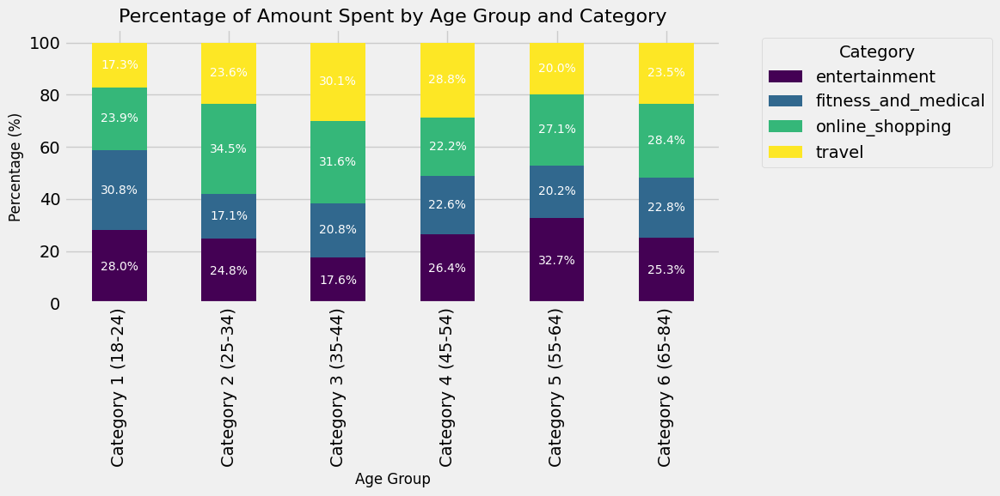

In [ ]:
# Plot stacked percentage bar graph
ax = pivot_df_percentage.plot(kind='bar', stacked=True, figsize=(12, 6), colormap='viridis')

plt.title('Percentage of Amount Spent by Age Group and Category', fontsize=16)
plt.ylabel('Percentage (%)', fontsize=12)
plt.xlabel('Age Group', fontsize=12)
plt.legend(title='Category', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Annotate percentages on the bars
for i, bar_group in enumerate(ax.containers):
    for bar in bar_group:
        height = bar.get_height()
        if height > 0:
            ax.text(
                bar.get_x() + bar.get_width() / 2,  # Center text horizontally
                bar.get_y() + height / 2,  # Center text vertically
                f'{height:.1f}%',  # Format percentage
                ha='center',
                va='center',
                fontsize=10,
                color='white'  # Use white text for better visibility
            )

plt.show()

In [ ]:
pip install adjustText

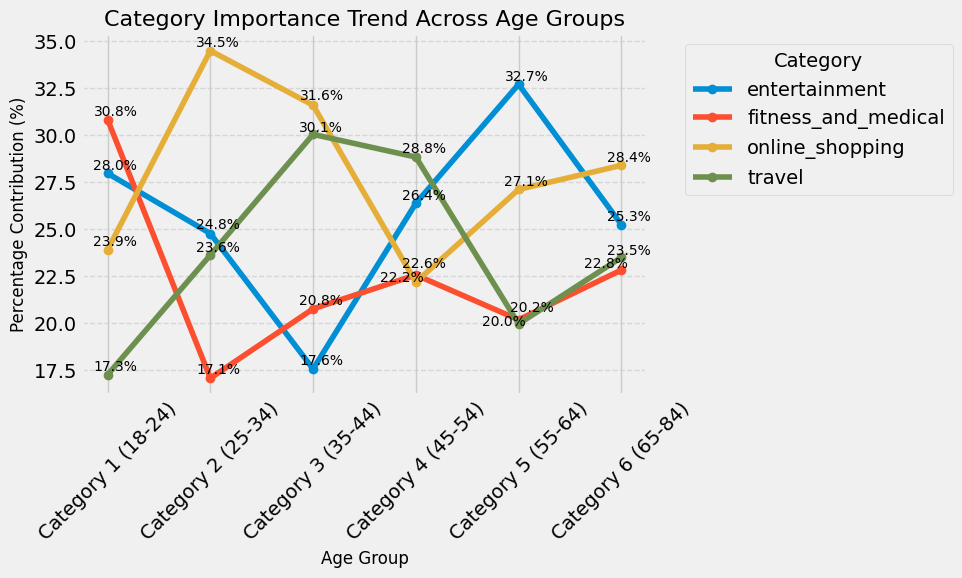

In [ ]:



# Transpose the pivot_df for category-wise trend analysis
#trend_data = pivot_df.T
trend_data = pivot_df_percentage.T
# Plot line chart to show the trend
plt.figure(figsize=(10, 6))

# Collect all text objects for adjust_text
texts = []

for category in trend_data.index:
    plt.plot(trend_data.columns, trend_data.loc[category], marker='o', label=category)

    # Add data labels (percentage values)
    for x, y in zip(trend_data.columns, trend_data.loc[category]):
        # Add the text to the list for adjustment
        texts.append(plt.text(x, y, f'{y:.1f}%', ha='center', va='bottom', fontsize=10))

# Automatically adjust text positions to avoid overlaps
from adjustText import adjust_text # Make sure to import adjustText after installation
adjust_text(texts, arrowprops=dict(arrowstyle='-', color='gray', lw=0.5))

# Add title, labels, and other plot details
plt.title("Category Importance Trend Across Age Groups", fontsize=16)
plt.xlabel("Age Group", fontsize=12)
plt.ylabel("Percentage Contribution (%)", fontsize=12)
plt.xticks(rotation=45)
plt.legend(title="Category", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()

# Show the plot
plt.show()

In [ ]:
# Transpose the pivot_df for category-wise trend analysis
trend_data = pivot_df.T

# Reset index for better readability
trend_data.reset_index(inplace=True)
trend_data.rename(columns={'index': 'category'}, inplace=True)

# Display the percentage contribution of each category across age groups
print("Category Importance Trend Across Age Groups:")
print(trend_data)

# Calculate the change in percentage contribution for each category between the first and last age groups
trend_data['trend_change'] = trend_data.iloc[:, -1] - trend_data.iloc[:, 1]

# Sort categories by the highest trend change (absolute value)
trend_data_sorted = trend_data.sort_values(by='trend_change', ascending=False, key=abs)

# Display sorted trends to show categories with increasing or decreasing importance
print("\nCategory Trend Changes (Sorted by Most Significant Change):")
print(trend_data_sorted[['category', 'trend_change']])


Category Importance Trend Across Age Groups:
age_group             category  Category 1 (18-24)  Category 2 (25-34)  \
0                entertainment           668695.83           739892.45   
1          fitness_and_medical           737138.39           510128.84   
2              online_shopping           571504.97          1030370.11   
3                       travel           412613.73           705774.61   

age_group  Category 3 (35-44)  Category 4 (45-54)  Category 5 (55-64)  \
0                   500496.70           795518.11           721531.84   
1                   591672.64           680603.53           445338.41   
2                   900232.73           669082.11           598199.77   
3                   856052.76           869675.28           440448.52   

age_group  Category 6 (65-84)  
0                  1562327.76  
1                  1412774.60  
2                  1757343.03  
3                  1454283.80  

Category Trend Changes (Sorted by Most Significant Change

In [ ]:
#unique months in 'trans_date_trans_time' column
df['trans_date_trans_time'] = pd.to_datetime(df['trans_date_trans_time'], format='%m-%d-%Y', errors='coerce')  # Specify the format to match your data
print(df['trans_date_trans_time'].dt.month.unique())

[ 4  2 10  6  3  5 12  7  8 11  9  1]


The data is divided across 3 years, 2022,2023, and 2024
1. Extract data for spending in 3 years seperately.Compare the spending between these 3 years, see what category saw a dip, analyze the trends in the categories across the 3 years
2. Compare which month saw the highest spending in a particular year
3. Compare the spending between a particular month across 3 years
4. Use category and transaction as the indicators
5. See what year saw the highest spending, in avg and in absolute terms.

In [ ]:
df.shape

(3877, 14)

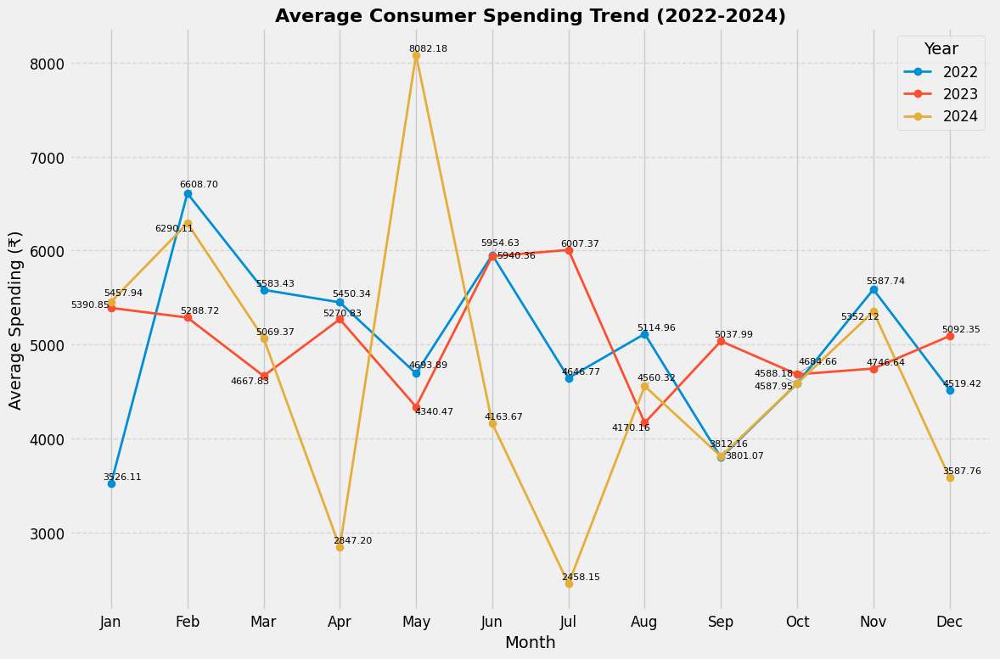

In [ ]:
# Convert the date column to datetime format
df['trans_date_trans_time'] = pd.to_datetime(df['trans_date_trans_time'], format='%Y-%m-%d %H:%M:%S', errors='coerce')

# Extract the year and month from the date column
df['year'] = df['trans_date_trans_time'].dt.year
df['month'] = df['trans_date_trans_time'].dt.month

# Group by year and month, then calculate the average spending
monthly_avg_spending = df.groupby(['year', 'month'])['amt'].mean().reset_index()

# Create month labels
month_labels = {1: 'Jan', 2: 'Feb', 3: 'Mar', 4: 'Apr', 5: 'May', 6: 'Jun',
                7: 'Jul', 8: 'Aug', 9: 'Sep', 10: 'Oct', 11: 'Nov', 12: 'Dec'}
monthly_avg_spending['Month'] = monthly_avg_spending['month'].map(month_labels)

# Pivot the data for easier plotting
pivot_data = monthly_avg_spending.pivot(index='month', columns='year', values='amt')

# Plot the data using a line graph with data labels
plt.figure(figsize=(12, 8))

# Collect all text objects for adjustments
texts = []

for year in pivot_data.columns:
    plt.plot(pivot_data.index, pivot_data[year], marker='o', label=f'{year}', linewidth=2)

    # Add data labels (average spending values)
    for x, y in zip(pivot_data.index, pivot_data[year]):
        if not pd.isna(y):  # Avoid adding text for missing data (NaN)
            texts.append(plt.text(x, y, f'{y:.2f}', ha='center', va='bottom', fontsize=8))

# Automatically adjust text positions to avoid overlaps (if needed)
from adjustText import adjust_text
adjust_text(texts, arrowprops=dict(arrowstyle='-', color='gray', lw=0.5))

# Customize the plot
plt.title('Average Consumer Spending Trend (2022-2024)', fontsize=16, weight='bold')
plt.xlabel('Month', fontsize=14)
plt.ylabel('Average Spending (₹)', fontsize=14)  # Changed "$" to "₹" as spending is in rupees
plt.xticks(ticks=range(1, 13), labels=[month_labels[m] for m in range(1, 13)], fontsize=12)
plt.yticks(fontsize=12)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.legend(title='Year', fontsize=12)
plt.tight_layout()

# Display the line graph
plt.show()


In [ ]:
print("Columns before:", df.columns)

print("Columns after:", df.columns)


Columns before: Index(['trans_date_trans_time', 'category', 'amt', 'gender', 'state', 'lat',
       'long', 'job', 'dob', 'merch_lat', 'merch_long', 'is_fraud', 'age',
       'age_group', 'year', 'month'],
      dtype='object')
Columns after: Index(['trans_date_trans_time', 'category', 'amt', 'gender', 'state', 'lat',
       'long', 'job', 'dob', 'merch_lat', 'merch_long', 'is_fraud', 'age',
       'age_group', 'year', 'month'],
      dtype='object')


In [ ]:
#  Convert the date column to datetime format
df['trans_date_trans_time'] = pd.to_datetime(df['trans_date_trans_time'], format='%Y-%m-%d %H:%M:%S', errors='coerce')

# Extract the year and month from the date column
df['year'] = df['trans_date_trans_time'].dt.year
df['month'] = df['trans_date_trans_time'].dt.month

# Group by year and month, then calculate the average spending
monthly_avg_spending = df.groupby(['year', 'month'])['amt'].mean().reset_index()

# Create month labels (for better readability in the output)
month_labels = {1: 'Jan', 2: 'Feb', 3: 'Mar', 4: 'Apr', 5: 'May', 6: 'Jun',
                7: 'Jul', 8: 'Aug', 9: 'Sep', 10: 'Oct', 11: 'Nov', 12: 'Dec'}
monthly_avg_spending['Month'] = monthly_avg_spending['month'].map(month_labels)

# Pivot the data for easier presentation
pivot_data = monthly_avg_spending.pivot(index='month', columns='year', values='amt')

# Print the pivot_data DataFrame (without visualization)
print(pivot_data)

year          2022         2023         2024
month                                       
1      3526.113077  5390.851406  5457.939512
2      6608.699714  5288.720510  6290.105000
3      5583.434630  4667.834286  5069.365350
4      5450.342087  5270.834574  2847.198000
5      4693.893243  4340.469508  8082.177778
6      5954.634361  5940.358841  4163.671667
7      4646.773898  6007.370926  2458.147500
8      5114.960196  4170.158235  4560.320000
9      3801.068623  5037.989404  3812.158462
10     4588.182759  4684.656788  4587.949091
11     5587.740397  4746.641554  5352.120000
12     4519.419892  5092.348658  3587.763774


In [ ]:
# Calculate standard deviation of spending for each month across years
monthly_std_dev = pivot_data.std(axis=1)

consistency_analysis = pd.DataFrame({
    'Month': [month_labels.get(m, str(m))  for m in pivot_data.index], # Using get() to handle potential missing keys
    'Standard Deviation': monthly_std_dev
})

print("Spending Consistency Analysis:")
print(consistency_analysis)

Spending Consistency Analysis:
      Month  Standard Deviation
month                          
1       Jan         1096.487059
2       Feb          688.793461
3       Mar          458.951415
4       Apr         1453.879656
5       May         2065.823532
6       Jun         1029.916540
7       Jul         1790.637536
8       Aug          474.781124
9       Sep          710.956809
10      Oct           55.766883
11      Nov          433.890997
12      Dec          759.386393


In [ ]:
df.head(10)

,trans_date_trans_time,category,amt,gender,state,lat,long,job,dob,merch_lat,merch_long,is_fraud,age,age_group,year,month
2,2023-04-25,entertainment,7568.37,M,Mizoram,76.196973,102.564244,Probation officer,1963-10-18,76.214025,102.567219,0.0,61,Category 5 (55-64),2023,4
4,2023-02-15,entertainment,5056.81,M,Jharkhand,81.974419,71.656847,Chiropodist,1994-01-19,81.959219,71.668432,0.0,30,Category 2 (25-34),2023,2
7,2023-10-06,fitness_and_medical,8760.33,F,Meghalaya,10.800613,128.719889,"Therapist, drama",2000-07-21,10.786513,128.737108,0.0,24,Category 1 (18-24),2023,10
16,2023-04-18,fitness_and_medical,542.89,M,Sikkim,28.890278,11.340253,"Conservator, museum-gallery",2005-11-02,28.897518,11.358012,1.0,19,Category 1 (18-24),2023,4
21,2023-06-29,entertainment,8250.53,F,Jharkhand,86.625582,-43.427319,"Designer, furniture",1953-07-03,86.610597,-43.420373,1.0,71,Category 6 (65-84),2023,6
26,2024-03-31,travel,9299.57,M,Kerala,-52.512839,-3.378810,Land,1939-02-11,-52.521642,-3.394619,0.0,85,Category 6 (65-84),2024,3
28,2023-05-16,online_shopping,7850.53,F,Karnataka,-3.866379,115.067332,Geophysicist-field seismologist,1957-07-01,-3.876539,115.081001,1.0,67,Category 6 (65-84),2023,5
32,2023-12-04,online_shopping,4552.75,M,Jharkhand,-66.115949,134.062572,Tour manager,1997-07-10,-66.132736,134.058921,0.0,27,Category 2 (25-34),2023,12
36,2023-04-25,fitness_and_medical,7241.17,M,Chhattisgarh,80.435079,-146.593280,TEFL teacher,1949-04-15,80.437231,-146.612827,0.0,75,Category 6 (65-84),2023,4
39,2022-07-11,fitness_and_medical,4149.20,M,Haryana,-74.848223,-14.958361,"Teacher, primary school",1945-11-22,-74.864731,-14.973647,0.0,79,Category 6 (65-84),2022,7


In [ ]:
# Convert the transaction date column to datetime format if it's not already
df['trans_date_trans_time'] = pd.to_datetime(df['trans_date_trans_time'])

# Extract the year from the trans_date_trans_time column
df['year'] = df['trans_date_trans_time'].dt.year

# Group by year and category and count the number of transactions
yearly_category_data = df.groupby(['year', 'category']).size().reset_index(name='transaction_count')

# Display the result
print(yearly_category_data)

    year             category  transaction_count
0   2022        entertainment                316
1   2022  fitness_and_medical                242
2   2022      online_shopping                403
3   2022               travel                313
4   2023        entertainment                565
5   2023  fitness_and_medical                505
6   2023      online_shopping                531
7   2023               travel                446
8   2024        entertainment                137
9   2024  fitness_and_medical                145
10  2024      online_shopping                152
11  2024               travel                122


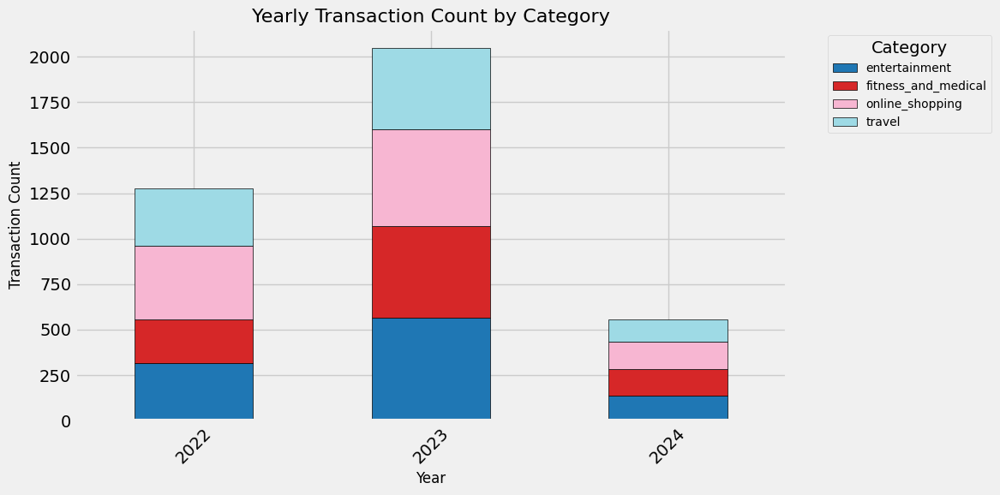

In [ ]:
# Pivot the data for a stacked bar chart
pivot_data = yearly_category_data.pivot(index='year', columns='category', values='transaction_count').fillna(0)

# Plot the stacked bar chart
pivot_data.plot(kind='bar', stacked=True, figsize=(12, 6), cmap='tab20', edgecolor='black')

# Add labels and title
plt.title('Yearly Transaction Count by Category', fontsize=16)
plt.xlabel('Year', fontsize=12)
plt.ylabel('Transaction Count', fontsize=12)
plt.legend(title='Category', fontsize=10, bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.tight_layout()

# Show the plot
plt.show()


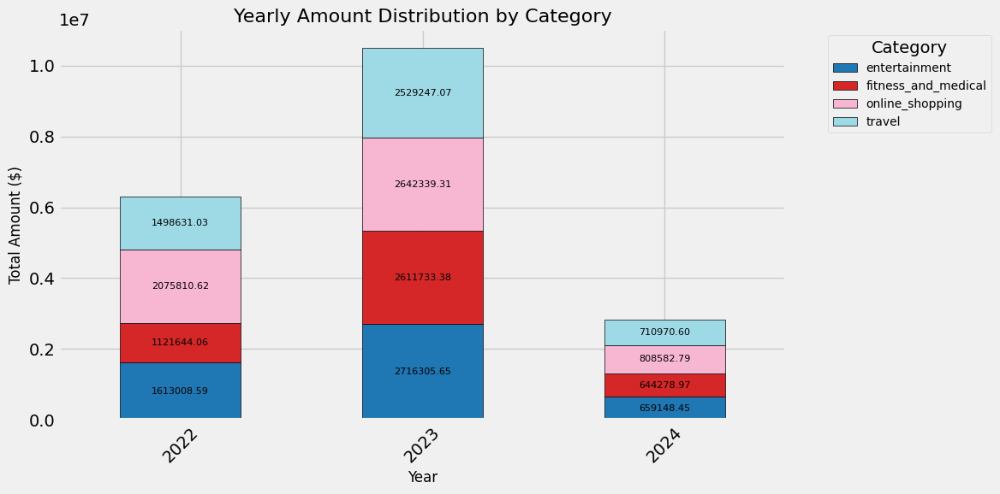

In [ ]:
# Group by year and category to sum the transaction amounts
yearly_category_data = df.groupby(['year', 'category'])['amt'].sum().reset_index()

# Pivot the data for a stacked bar chart
pivot_data = yearly_category_data.pivot(index='year', columns='category', values='amt').fillna(0)

# Plot the stacked bar chart
fig, ax = plt.subplots(figsize=(12, 6))
bars = pivot_data.plot(kind='bar', stacked=True, ax=ax, cmap='tab20', edgecolor='black')

# Annotate the bars with data values
for bar in bars.containers:
    for rect in bar:
        height = rect.get_height()
        if height > 0:  # Only annotate bars with positive height
            ax.text(
                rect.get_x() + rect.get_width() / 2,  # X-coordinate
                rect.get_y() + height / 2,  # Y-coordinate (center of the bar)
                f'{height:.2f}',  # Format the value
                ha='center', va='center', fontsize=8, color='black'
            )

# Add labels and title
ax.set_title('Yearly Amount Distribution by Category', fontsize=16)
ax.set_xlabel('Year', fontsize=12)
ax.set_ylabel('Total Amount ($)', fontsize=12)
ax.legend(title='Category', fontsize=10, bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.tight_layout()

# Show the plot
plt.show()


In [ ]:
df.shape

(3877, 16)

In [ ]:
# Convert 'trans_date_trans_time' to datetime format and extract year
df['trans_date_trans_time'] = pd.to_datetime(df['trans_date_trans_time'])
df['year'] = df['trans_date_trans_time'].dt.year

#  Group data by 'year' and 'category' and calculate average 'amt'
avg_amt_per_year_category = df.groupby(['year', 'category'])['amt'].mean().reset_index()

#  Rename columns for clarity
avg_amt_per_year_category.rename(columns={'amt': 'average_amt'}, inplace=True)

# Display the result
print(avg_amt_per_year_category)




    year             category  average_amt
0   2022        entertainment  5104.457563
1   2022  fitness_and_medical  4634.892810
2   2022      online_shopping  5150.894839
3   2022               travel  4787.958562
4   2023        entertainment  4807.620619
5   2023  fitness_and_medical  5171.749267
6   2023      online_shopping  4976.156893
7   2023               travel  5670.957556
8   2024        entertainment  4811.302555
9   2024  fitness_and_medical  4443.303241
10  2024      online_shopping  5319.623618
11  2024               travel  5827.627869


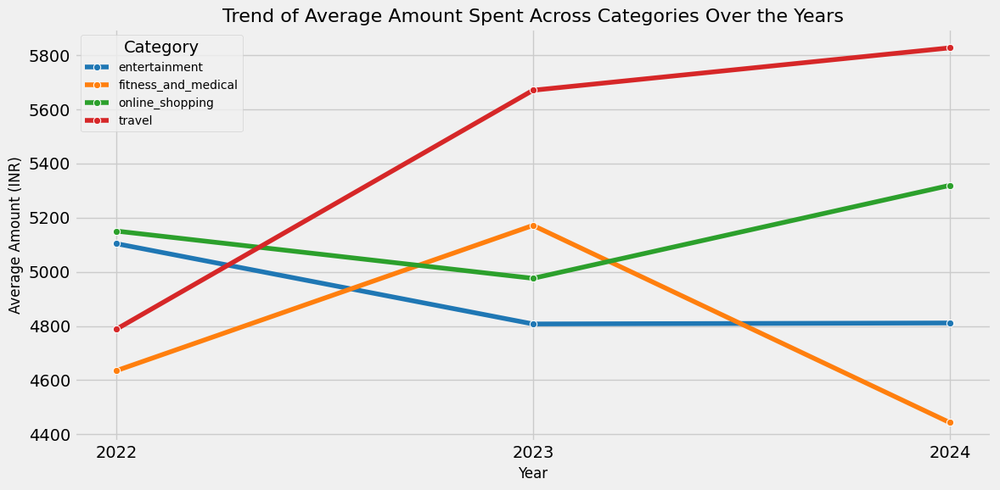

In [ ]:
# Convert year to string to treat it as a categorical variable
avg_amt_per_year_category['year'] = avg_amt_per_year_category['year'].astype(str)

# Create a line plot
plt.figure(figsize=(12, 6))
sns.lineplot(data=avg_amt_per_year_category, x='year', y='average_amt', hue='category', marker='o', palette='tab10')

# Add labels and title
plt.title('Trend of Average Amount Spent Across Categories Over the Years', fontsize=16)
plt.xlabel('Year', fontsize=12)
plt.ylabel('Average Amount (INR)', fontsize=12)
plt.legend(title='Category', fontsize=10)
plt.grid(True)
plt.tight_layout()

# Show the plot
plt.show()


**Comparing which month saw the highest spending in a particular year**

<ipython-input-283-2fe180e21e37>:22: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  monthly_spending_all_years['amt'].fillna(0, inplace=True)


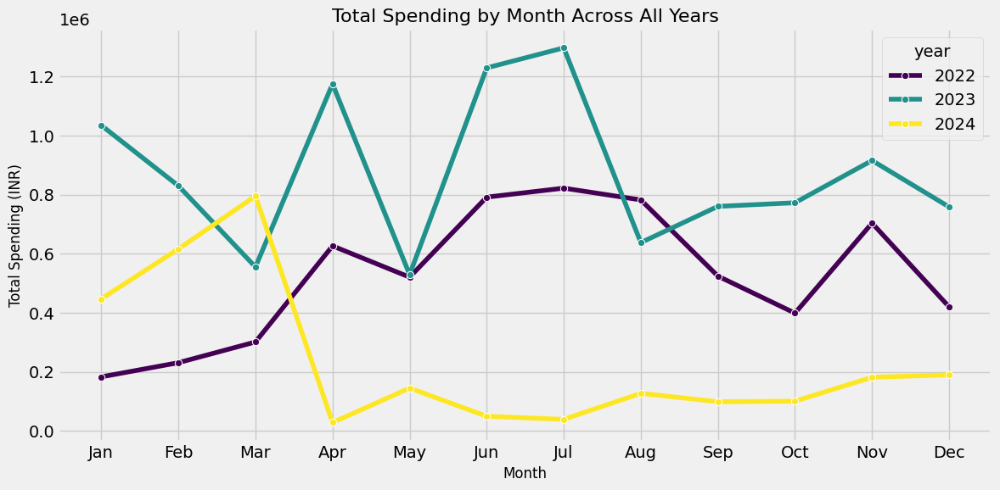

In [ ]:
# Convert 'trans_date_trans_time' to datetime format
df['trans_date_trans_time'] = pd.to_datetime(df['trans_date_trans_time'])

# Extract month and year
df['month'] = df['trans_date_trans_time'].dt.month
df['year'] = df['trans_date_trans_time'].dt.year

# Group by year and month, calculate total spending
monthly_spending_all_years = df.groupby(['year', 'month'])['amt'].sum().reset_index()

# Create a DataFrame with all months for the x-axis
all_months = pd.DataFrame({'month': range(1, 13)})

# Merge to ensure all months are included, fill missing values with 0
monthly_spending_all_years = pd.merge(all_months, monthly_spending_all_years, on='month', how='left')
monthly_spending_all_years['amt'].fillna(0, inplace=True)

# Create the line plot
plt.figure(figsize=(12, 6))
sns.lineplot(data=monthly_spending_all_years, x='month', y='amt', hue='year', marker='o', palette='viridis')

# Customize and display the plot
plt.title('Total Spending by Month Across All Years', fontsize=16)
plt.xlabel('Month', fontsize=12)
plt.ylabel('Total Spending (INR)', fontsize=12)
plt.xticks(range(1, 13), ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']) # Set x-axis ticks to show all months
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
df.columns

Index(['trans_date_trans_time', 'category', 'amt', 'gender', 'state', 'lat',
       'long', 'job', 'dob', 'merch_lat', 'merch_long', 'is_fraud', 'age',
       'age_group', 'year', 'month'],
      dtype='object')

## Extracting Insights for Launching a Health-focused product, i.e. a Fitbit Band

In [ ]:
# Filter Data Relevant to Fitbit Band (Fitness and Medical category)
fitness_data = df[df['category'] == 'fitness_and_medical']

# Basic Statistical Analysis
mean_amt = fitness_data['amt'].mean()
median_amt = fitness_data['amt'].median()
std_dev_amt = fitness_data['amt'].std()
iqr_amt = fitness_data['amt'].quantile(0.75) - fitness_data['amt'].quantile(0.25)

# Percentiles
percentile_25 = fitness_data['amt'].quantile(0.25)
percentile_50 = fitness_data['amt'].quantile(0.50)
percentile_75 = fitness_data['amt'].quantile(0.75)

# Display Results
print("Basic Statistical Analysis for Fitbit Band Pricing:")
print(f"Mean Amount: ₹{mean_amt:.2f}")
print(f"Median Amount: ₹{median_amt:.2f}")
print(f"Standard Deviation: ₹{std_dev_amt:.2f}")
print(f"Interquartile Range (IQR): ₹{iqr_amt:.2f}")
print(f"25th Percentile: ₹{percentile_25:.2f}")
print(f"50th Percentile (Median): ₹{percentile_50:.2f}")
print(f"75th Percentile: ₹{percentile_75:.2f}")

# Suggested Price Range
lower_price = max(percentile_25, mean_amt - std_dev_amt)  # Ensure price is not too low
upper_price = min(percentile_75, mean_amt + std_dev_amt)  # Ensure price is not too high
print(f"\nSuggested Price Range for Fitbit Band: ₹{lower_price:.2f} - ₹{upper_price:.2f}")


Basic Statistical Analysis for Fitbit Band Pricing:
Mean Amount: ₹4907.69
Median Amount: ₹4709.32
Standard Deviation: ₹2663.09
Interquartile Range (IQR): ₹4255.66
25th Percentile: ₹2754.94
50th Percentile (Median): ₹4709.32
75th Percentile: ₹7010.60

Suggested Price Range for Fitbit Band: ₹2754.94 - ₹7010.60


In [ ]:
# Filter Data Relevant to Fitbit Band (Fitness and Medical category)
# Updated to use 'fitness' instead of 'fitness_and_medical'
# Check unique categories to find the correct name
print(df['category'].unique())  # Print unique categories to verify

# Using the correct category name based on the output of the above print statement
# Example: If the correct category name is 'fitness_and_medical', then use:
fitness_data = df[df['category'] == 'fitness_and_medical']




['entertainment' 'fitness_and_medical' 'travel' 'online_shopping']


In [ ]:
# Group data by state and category to calculate statistics
state_category_stats = df.groupby(['state', 'category'])['amt'].agg(['mean', 'std', 'var']).reset_index()
print(state_category_stats)


                 state             category         mean          std  \
0       Andhra Pradesh        entertainment  5378.422075  3027.432777   
1       Andhra Pradesh  fitness_and_medical  7908.728000   783.626669   
2       Andhra Pradesh      online_shopping  4629.043333  2800.795594   
3       Andhra Pradesh               travel  3754.626667  2453.734199   
4    Arunachal Pradesh        entertainment  6002.728333  1756.044722   
5    Arunachal Pradesh  fitness_and_medical  7021.995313  1818.814488   
6    Arunachal Pradesh      online_shopping  4253.379063  3703.684223   
7    Arunachal Pradesh               travel  4325.767742  2284.355056   
8                Assam        entertainment  5597.133333  1527.576449   
9                Assam  fitness_and_medical  5242.766286  3273.262139   
10               Assam      online_shopping  4445.507308  1947.297274   
11               Assam               travel  5560.705152  1877.701885   
12               Bihar        entertainment  3202.4

In [ ]:
# Pivot data for correlation analysis
category_pivot = df.pivot_table(values='amt', index='state', columns='category', aggfunc='sum').fillna(0)

# Calculate correlation matrix
correlation_matrix = category_pivot.corr()
print(correlation_matrix)


category             entertainment  fitness_and_medical  online_shopping  \
category                                                                   
entertainment             1.000000             0.077877        -0.194238   
fitness_and_medical       0.077877             1.000000         0.036099   
online_shopping          -0.194238             0.036099         1.000000   
travel                    0.156596            -0.377517        -0.088131   

category               travel  
category                       
entertainment        0.156596  
fitness_and_medical -0.377517  
online_shopping     -0.088131  
travel               1.000000  


In [ ]:
# Group by year and month, calculate average spending
monthly_stats = df.groupby(['year', 'month'])['amt'].agg(['mean', 'std', 'sum']).reset_index()

# Identify best and worst months
best_month = monthly_stats.loc[monthly_stats['mean'].idxmax()]
worst_month = monthly_stats.loc[monthly_stats['mean'].idxmin()]
print(f"Best Month: {best_month}")
print(f"Worst Month: {worst_month}")


Best Month: year       2024.000000
month         5.000000
mean       8082.177778
std         986.235166
sum      145479.200000
Name: 28, dtype: float64
Worst Month: year      2024.000000
month        7.000000
mean      2458.147500
std        714.678631
sum      39330.360000
Name: 30, dtype: float64


In [ ]:
# Group by age group and category
age_group_stats = df.groupby(['age_group', 'category'])['amt'].agg(['mean', 'std', 'sum']).reset_index()
print(age_group_stats)


             age_group             category         mean          std  \
0   Category 1 (18-24)        entertainment  4457.972200  2658.561428   
1   Category 1 (18-24)  fitness_and_medical  5265.274214  2971.748792   
2   Category 1 (18-24)      online_shopping  5243.164862  2627.542026   
3   Category 1 (18-24)               travel  6158.413881  2560.350635   
4   Category 2 (25-34)        entertainment  5174.073077  3204.778681   
5   Category 2 (25-34)  fitness_and_medical  4397.662414  1953.757400   
6   Category 2 (25-34)      online_shopping  5100.842129  2680.452157   
7   Category 2 (25-34)               travel  5691.730726  2994.478806   
8   Category 3 (35-44)        entertainment  4812.468269  3054.382625   
9   Category 3 (35-44)  fitness_and_medical  4318.778394  2568.235969   
10  Category 3 (35-44)      online_shopping  5556.992160  2885.422207   
11  Category 3 (35-44)               travel  4948.281850  3058.199392   
12  Category 4 (45-54)        entertainment  5132.3

<ipython-input-290-63755f1825fc>:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  age_group_stats = df.groupby(['age_group', 'category'])['amt'].agg(['mean', 'std', 'sum']).reset_index()


In [ ]:
# Filter for fitness and medical category
fitness_medical_data = df[df['category'] == 'fitness_and_medical']

# Group by state
top_states = fitness_medical_data.groupby('state')['amt'].agg(['sum', 'mean', 'std', 'count']).reset_index()
print(top_states.sort_values(by='sum', ascending=False).head())


          state        sum         mean          std  count
16      Mizoram  356158.22  6475.604000  2555.597979     55
13  Maharashtra  295256.02  6282.042979  2171.082538     47
10    Karnataka  281017.56  5979.097021  2756.920452     47
24      Tripura  275738.83  5514.776600  2506.461228     50
3         Bihar  248707.26  5783.889767  2494.647407     43


In [ ]:
df.columns

Index(['trans_date_trans_time', 'category', 'amt', 'gender', 'state', 'lat',
       'long', 'job', 'dob', 'merch_lat', 'merch_long', 'is_fraud', 'age',
       'age_group', 'year', 'month'],
      dtype='object')

<ipython-input-293-d60b56fe43c0>:19: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x="state", y="sum", data=top_states, palette="Blues_d", edgecolor="black")


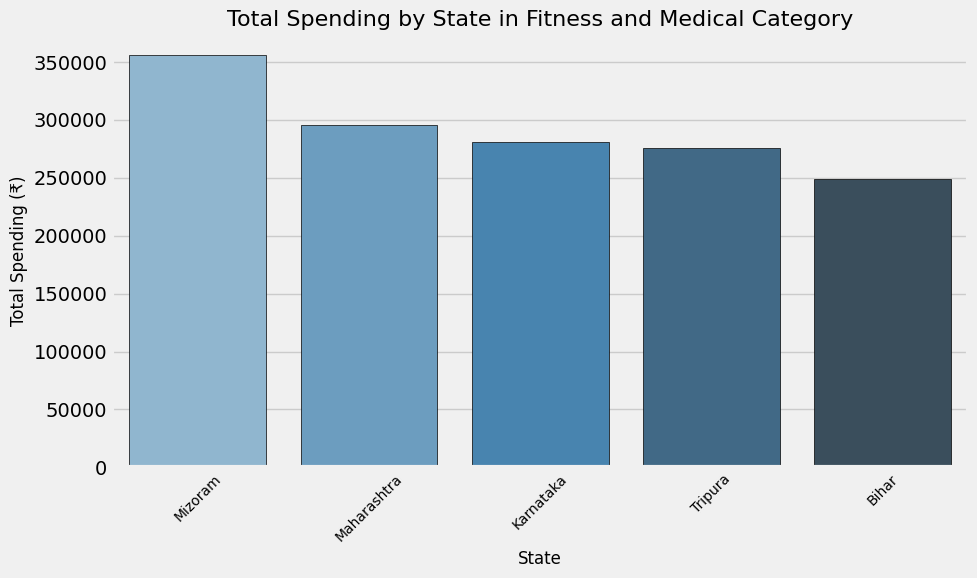

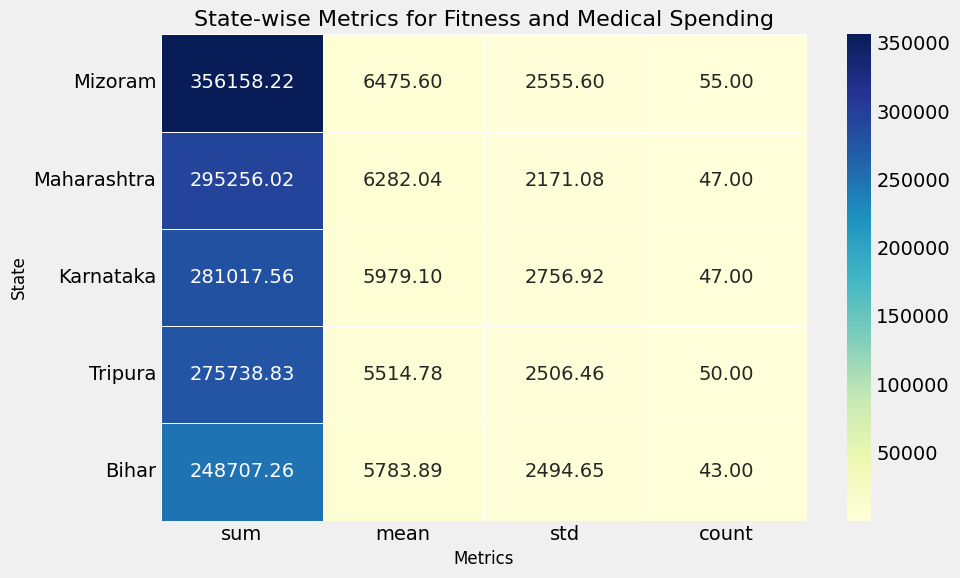

In [ ]:
data = {
    "state": ["Mizoram", "Maharashtra", "Karnataka", "Tripura", "Bihar"],
    "sum": [356158.22, 295256.02, 281017.56, 275738.83, 248707.26],
    "mean": [6475.60, 6282.04, 5979.10, 5514.78, 5783.89],
    "std": [2555.60, 2171.08, 2756.92, 2506.46, 2494.65],
    "count": [55, 47, 47, 50, 43]
}

top_states = pd.DataFrame(data)

# Bar chart for total spending by state
plt.figure(figsize=(10, 6))
sns.barplot(x="state", y="sum", data=top_states, palette="Blues_d", edgecolor="black")
plt.title("Total Spending by State in Fitness and Medical Category", fontsize=16)
plt.xlabel("State", fontsize=12)
plt.ylabel("Total Spending (₹)", fontsize=12)
plt.xticks(rotation=45, fontsize=10)
plt.tight_layout()
plt.show()

# Heatmap for detailed metrics (sum, mean, std, count)
plt.figure(figsize=(10, 6))
sns.heatmap(top_states.set_index("state")[["sum", "mean", "std", "count"]],
            annot=True, fmt=".2f", cmap="YlGnBu", linewidths=0.5)
plt.title("State-wise Metrics for Fitness and Medical Spending", fontsize=16)
plt.xlabel("Metrics", fontsize=12)
plt.ylabel("State", fontsize=12)
plt.tight_layout()
plt.show()


In [ ]:
df.columns

Index(['trans_date_trans_time', 'category', 'amt', 'gender', 'state', 'lat',
       'long', 'job', 'dob', 'merch_lat', 'merch_long', 'is_fraud', 'age',
       'age_group', 'year', 'month'],
      dtype='object')

In [ ]:
df.columns

Index(['trans_date_trans_time', 'category', 'amt', 'gender', 'state', 'lat',
       'long', 'job', 'dob', 'merch_lat', 'merch_long', 'is_fraud', 'age',
       'age_group', 'year', 'month'],
      dtype='object')

In [ ]:
# Group by age_group and category, summing the amount
age_category_spending = df.groupby(['age_group', 'category'])['amt'].sum().reset_index()

# View the result
print(age_category_spending)



             age_group             category         amt
0   Category 1 (18-24)        entertainment   668695.83
1   Category 1 (18-24)  fitness_and_medical   737138.39
2   Category 1 (18-24)      online_shopping   571504.97
3   Category 1 (18-24)               travel   412613.73
4   Category 2 (25-34)        entertainment   739892.45
5   Category 2 (25-34)  fitness_and_medical   510128.84
6   Category 2 (25-34)      online_shopping  1030370.11
7   Category 2 (25-34)               travel   705774.61
8   Category 3 (35-44)        entertainment   500496.70
9   Category 3 (35-44)  fitness_and_medical   591672.64
10  Category 3 (35-44)      online_shopping   900232.73
11  Category 3 (35-44)               travel   856052.76
12  Category 4 (45-54)        entertainment   795518.11
13  Category 4 (45-54)  fitness_and_medical   680603.53
14  Category 4 (45-54)      online_shopping   669082.11
15  Category 4 (45-54)               travel   869675.28
16  Category 5 (55-64)        entertainment   72

<ipython-input-296-868df0b897ed>:6: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  age_category_spending = df.groupby(['age_group', 'category'])['amt'].sum().reset_index()


In [ ]:
# Find the category with maximum spending for each age group
dominant_categories = age_category_spending.loc[age_category_spending.groupby('age_group')['amt'].idxmax()]
print(dominant_categories)


             age_group             category         amt
1   Category 1 (18-24)  fitness_and_medical   737138.39
6   Category 2 (25-34)      online_shopping  1030370.11
10  Category 3 (35-44)      online_shopping   900232.73
15  Category 4 (45-54)               travel   869675.28
16  Category 5 (55-64)        entertainment   721531.84
22  Category 6 (65-84)      online_shopping  1757343.03


<ipython-input-297-3b30f22f36a1>:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dominant_categories = age_category_spending.loc[age_category_spending.groupby('age_group')['amt'].idxmax()]


In [ ]:
# Calculate total spending per age group
total_spending_per_age = df.groupby('age_group')['amt'].sum().reset_index()
total_spending_per_age.columns = ['age_group', 'total_amt']

# Merge total spending back to the grouped data
age_category_spending = age_category_spending.merge(total_spending_per_age, on='age_group')

# Calculate percentage contribution
age_category_spending['percentage'] = (age_category_spending['amt'] / age_category_spending['total_amt']) * 100
print(age_category_spending)


             age_group             category         amt   total_amt  \
0   Category 1 (18-24)        entertainment   668695.83  2389952.92   
1   Category 1 (18-24)  fitness_and_medical   737138.39  2389952.92   
2   Category 1 (18-24)      online_shopping   571504.97  2389952.92   
3   Category 1 (18-24)               travel   412613.73  2389952.92   
4   Category 2 (25-34)        entertainment   739892.45  2986166.01   
5   Category 2 (25-34)  fitness_and_medical   510128.84  2986166.01   
6   Category 2 (25-34)      online_shopping  1030370.11  2986166.01   
7   Category 2 (25-34)               travel   705774.61  2986166.01   
8   Category 3 (35-44)        entertainment   500496.70  2848454.83   
9   Category 3 (35-44)  fitness_and_medical   591672.64  2848454.83   
10  Category 3 (35-44)      online_shopping   900232.73  2848454.83   
11  Category 3 (35-44)               travel   856052.76  2848454.83   
12  Category 4 (45-54)        entertainment   795518.11  3014879.03   
13  Ca

<ipython-input-298-e4311e491de7>:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  total_spending_per_age = df.groupby('age_group')['amt'].sum().reset_index()


In [ ]:
# Pivot data for variance analysis
pivot_data = df.pivot_table(index='age_group', columns='category', values='amt', aggfunc='sum', fill_value=0)

# Calculate variance and standard deviation
variance = pivot_data.var(axis=1)
std_dev = pivot_data.std(axis=1)
print("Variance per age group:")
print(variance)
print("Standard deviation per age group:")
print(std_dev)


Variance per age group:
age_group
Category 1 (18-24)    1.980880e+10
Category 2 (25-34)    4.605192e+10
Category 3 (35-44)    3.846501e+10
Category 4 (45-54)    9.234100e+09
Category 5 (55-64)    1.823145e+10
Category 6 (65-84)    2.369716e+10
dtype: float64
Standard deviation per age group:
age_group
Category 1 (18-24)    140743.738802
Category 2 (25-34)    214597.122417
Category 3 (35-44)    196124.982315
Category 4 (45-54)     96094.223843
Category 5 (55-64)    135023.888729
Category 6 (65-84)    153938.817396
dtype: float64


<ipython-input-299-7cd74fa564af>:2: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  pivot_data = df.pivot_table(index='age_group', columns='category', values='amt', aggfunc='sum', fill_value=0)


In [ ]:
# Group data by age group and year (if available) to track trends
trends = df.groupby(['age_group', 'year'])['amt'].sum().reset_index()

# Pivot data to observe trends
trend_pivot = trends.pivot(index='year', columns='age_group', values='amt')
print(trend_pivot)


age_group  Category 1 (18-24)  Category 2 (25-34)  Category 3 (35-44)  \
year                                                                    
2022                837562.87           946171.68          1091482.67   
2023               1301618.10          1646584.97          1443373.37   
2024                250771.95           393409.36           313598.79   

age_group  Category 4 (45-54)  Category 5 (55-64)  Category 6 (65-84)  
year                                                                   
2022                794014.17           834765.54          1805097.37  
2023               1749620.19           990854.23          3367574.55  
2024                471244.67           379898.77          1014057.27  


<ipython-input-300-36a4af088fb4>:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  trends = df.groupby(['age_group', 'year'])['amt'].sum().reset_index()


<ipython-input-301-8277539eb219>:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  total_spending = df.groupby('age_group')['amt'].sum().reset_index()
<ipython-input-301-8277539eb219>:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=total_spending, x='age_group', y='amt', palette='coolwarm', edgecolor='black')


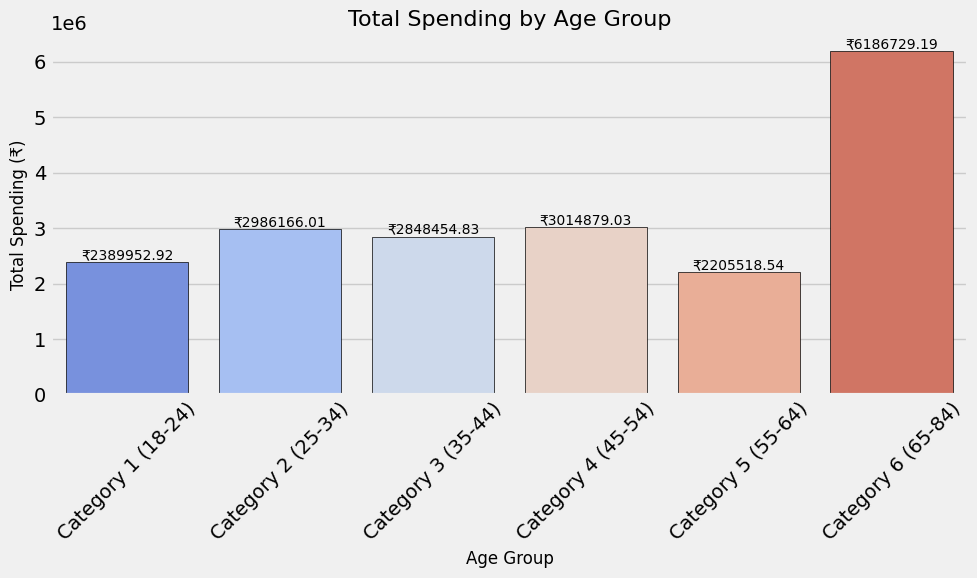

In [ ]:
# Calculate total spending per age group
total_spending = df.groupby('age_group')['amt'].sum().reset_index()

# Plot bar chart
plt.figure(figsize=(10, 6))
sns.barplot(data=total_spending, x='age_group', y='amt', palette='coolwarm', edgecolor='black')

# Add annotations
for index, row in total_spending.iterrows():
    plt.text(index, row['amt'] + 50000, f"₹{row['amt']:.2f}", ha='center', fontsize=10)

# Customize the plot
plt.title('Total Spending by Age Group', fontsize=16)
plt.xlabel('Age Group', fontsize=12)
plt.ylabel('Total Spending (₹)', fontsize=12)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


In [ ]:
# check null values in age group
df['age_group'].isnull().sum()

0

In [ ]:
# show number of unique values in job
df['job'].nunique()

382

In [ ]:
#show unique values in job
df['job'].unique()

array(['Probation officer', 'Chiropodist', 'Therapist, drama',
       'Conservator, museum-gallery', 'Designer, furniture', 'Land',
       'Geophysicist-field seismologist', 'Tour manager', 'TEFL teacher',
       'Teacher, primary school', 'Police officer',
       'Scientist, research (life sciences)', 'Psychotherapist, child',
       'Telecommunications researcher', 'Engineer, building services',
       'Osteopath', 'Chartered public finance accountant',
       'Forensic psychologist', 'Farm manager',
       'Armed forces training and education officer',
       'Editor, film-video', 'Recruitment consultant',
       'Surveyor, hydrographic', 'Clinical psychologist',
       'Teacher, music', 'Aeronautical engineer', 'Engineering geologist',
       'Accountant, chartered management', "Politician's assistant",
       'Adult guidance worker', 'Geneticist, molecular',
       'Armed forces logistics-support-administrative officer', 'Gaffer',
       'Operational researcher', 'Marine scientist

In [ ]:
df.columns

Index(['trans_date_trans_time', 'category', 'amt', 'gender', 'state', 'lat',
       'long', 'job', 'dob', 'merch_lat', 'merch_long', 'is_fraud', 'age',
       'age_group', 'year', 'month'],
      dtype='object')

In [ ]:
# Group the data by Job and Category, and calculate total spending
grouped_data = df.groupby(['job', 'category'])['amt'].sum().reset_index()

# Filter the data for the "Fitness and Medical" category
fitness_medical_data = grouped_data[grouped_data['category'] == 'fitness_and_medical']

# Identify the job that spends the most in the "Fitness and Medical" category
if not fitness_medical_data.empty:
    top_job = fitness_medical_data.loc[fitness_medical_data['amt'].idxmax()]
    print("job that spends the most in the 'Fitness and Medical' category:")
    print(f"job: {top_job['job']}, Total Spending: ₹{top_job['amt']}")
else:
    print("No data found for the 'Fitness and Medical' category.")

# Analyze overall job spending patterns across all categories
top_spending_by_job = grouped_data.groupby('job')['amt'].sum().sort_values(ascending=False).reset_index()
print("\nTop spending jobs across all categories:")
print(top_spending_by_job.head(10))  # Display top 10 jobs with the highest total spending


job that spends the most in the 'Fitness and Medical' category:
job: Chief Technology Officer, Total Spending: ₹122429.05000000002

Top spending jobs across all categories:
                                  job        amt
0         Passenger transport manager  193759.71
1                     Event organiser  178076.85
2                   Software engineer  169380.24
3                   Financial adviser  160468.03
4         Engineer, building services  146217.27
5            Chief Technology Officer  145093.63
6                Engineer, automotive  143045.58
7     Commercial-residential surveyor  142090.76
8          Television camera operator  139881.10
9  Logistics and distribution manager  139179.46


In [ ]:
# Group the data by Job and Category, and calculate total spending
grouped_data = df.groupby(['job', 'category'])['amt'].sum().reset_index()

# Sort by spending within each category to find the top jobs
sorted_data = grouped_data.sort_values(by='amt', ascending=False)

# Identify the top 10 jobs with their spending and categories
top_jobs = sorted_data.head(10)  # Adjust the number if you want more results

print("Top 10 jobs with the highest spending across categories:")
print(top_jobs)


Top 10 jobs with the highest spending across categories:
                             job             category        amt
192            Financial adviser               travel  160468.03
486    Trading standards officer        entertainment  136915.08
181              Event organiser      online_shopping  134032.90
284          Magazine journalist      online_shopping  129297.17
72      Chief Technology Officer  fitness_and_medical  122429.05
331  Passenger transport manager        entertainment  119783.06
388    Publishing rights manager  fitness_and_medical  119271.96
438            Software engineer               travel  118613.85
178                   Ergonomist      online_shopping  118452.72
273            Librarian, public  fitness_and_medical  117399.05


In [ ]:
# Define a function to categorize job titles
def categorize_job_title(job_title):
    """
    Categorizes a job title into broad occupation fields based on predefined keywords.

    Parameters:
    job_title (str): The job title to categorize.

    Returns:
    str: The occupation category (STEM, Arts and Humanities, Social Sciences and Services, Business and Management, or Other).
    """
    stem_keywords = [
        "engineer", "scientist", "technologist", "physicist", "chemist",
        "mathematician", "programmer", "developer", "geologist", "data", "aeronautical",
        "biomedical", "hydrologist", "research"
    ]
    arts_keywords = [
        "artist", "writer", "journalist", "designer", "curator", "dancer", "musician",
        "librarian", "drama", "film", "theatre", "arts", "historian"
    ]
    social_services_keywords = [
        "psychologist", "teacher", "social", "counselor", "officer", "administrator",
        "lawyer", "nurse", "doctor", "therapist", "paramedic", "conservation",
        "police", "judge", "policy", "civil"
    ]
    business_keywords = [
        "manager", "executive", "consultant", "accountant", "director", "banker",
        "entrepreneur", "planner", "officer", "investment", "trader", "risk", "logistics"
    ]

    job_title_lower = job_title.lower()  # Convert to lowercase for keyword matching

    # Match against keywords
    if any(keyword in job_title_lower for keyword in stem_keywords):
        return "STEM"
    elif any(keyword in job_title_lower for keyword in arts_keywords):
        return "Arts and Humanities"
    elif any(keyword in job_title_lower for keyword in social_services_keywords):
        return "Social Sciences and Services"
    elif any(keyword in job_title_lower for keyword in business_keywords):
        return "Business and Management"
    else:
        return "Other"

job_titles = [
    'Probation officer', 'Chiropodist', 'Therapist, drama',
    'Conservator, museum-gallery', 'Designer, furniture', 'Land',
    'Geophysicist-field seismologist', 'Tour manager', 'TEFL teacher',
    'Teacher, primary school', 'Police officer', 'Scientist, research (life sciences)',
    'Psychotherapist, child', 'Telecommunications researcher', 'Engineer, building services',
    'Osteopath', 'Chartered public finance accountant', 'Forensic psychologist', 'Farm manager',
    'Armed forces training and education officer', 'Editor, film-video', 'Recruitment consultant',
    'Surveyor, hydrographic', 'Clinical psychologist', 'Teacher, music', 'Aeronautical engineer',
    'Engineering geologist', 'Accountant, chartered management', "Politician's assistant",
    'Adult guidance worker', 'Geneticist, molecular', 'Armed forces logistics-support-administrative officer',
    'Gaffer', 'Operational researcher', 'Marine scientist', 'Engineer, site',
    'Multimedia specialist', 'Risk analyst', 'Ophthalmologist', 'Journalist, newspaper',
    'Forest-woodland manager', 'Therapist, horticultural', 'Advertising copywriter',
    'Health service manager', 'Museum-gallery curator', 'Tourism officer', 'Astronomer',
    'Merchandiser, retail', 'Passenger transport manager', 'Sports administrator',
    'Manufacturing engineer', 'Administrator, Civil Service'
]

# Creating a DataFrame with the job titles

job_df = pd.DataFrame(job_titles, columns=["Job Title"])

# Categorize each job title
job_df["Occupation Field"] = job_df["Job Title"].apply(categorize_job_title)

# Display the resulting DataFrame
print(job_df)


                                            Job Title  \
0                                   Probation officer   
1                                         Chiropodist   
2                                    Therapist, drama   
3                         Conservator, museum-gallery   
4                                 Designer, furniture   
5                                                Land   
6                     Geophysicist-field seismologist   
7                                        Tour manager   
8                                        TEFL teacher   
9                             Teacher, primary school   
10                                     Police officer   
11                Scientist, research (life sciences)   
12                             Psychotherapist, child   
13                      Telecommunications researcher   
14                        Engineer, building services   
15                                          Osteopath   
16                Chartered pub

In [ ]:
df.columns

Index(['trans_date_trans_time', 'category', 'amt', 'gender', 'state', 'lat',
       'long', 'job', 'dob', 'merch_lat', 'merch_long', 'is_fraud', 'age',
       'age_group', 'year', 'month'],
      dtype='object')

In [ ]:
# Define a function to categorize job titles into occupation fields
def categorize_job_title(job):
    """
    Categorizes a job title into broad occupation fields based on predefined keywords.
    """
    stem_keywords = [
        "engineer", "scientist", "technologist", "physicist", "chemist", "seismic interpreter",
        "acupuncturist", "archaeologist", "optician", "exercise physiologist", "herpetologist",
        "statistician", "mathematician", "programmer", "developer", "geologist", "data", "aeronautical", "intelligence analyst", "pharmacist", "dietitian", "embryologist, clinical",
        "landscape architect", "oncologist", "biomedical", "hydrologist", "research", "chiropodist", "geneticist, molecular", "ophthalmologist", "astronomer", "pharmacologist",
        "pathologist, diagnostic", "pilot, airline", "psychiatrist", "haematologist", "optometrist", "tree surgeon", "minerals surveyor", "land-geomatics surveyor",
        "surveyor, minerals", "osteopath", "hydrographic", "architect", "horticulturist, amenity",
        "microbiologist", "therapist", "paramedic", "homeopath", "hospital pharmacist",
        "ergonomist", "surgeon", "orthoptist", "clinical embryologist", "psychologist"  "Pathologist", "Environmental health practitioner", "Radiographer, diagnostic","Diagnostic radiographer", "Airline pilot", "Camera operator", "Lexicographer"
    ]
    arts_keywords = [
        "artist", "writer", "journalist", "designer", "curator", "dancer", "musician",
        "librarian", "drama", "film", "theatre", "arts", "historian" "artist", "writer", "journalist", "designer", "curator", "dancer", "musician"
         "librarian", "drama", "film", "theatre", "arts", "historian", "editor, film-video", "lecturer, further education", "air broker", "interpreter", "financial controller",
         "surveyor, insurance", "broadcast presenter", "music tutor", "technical author",
        "printmaker", "horticulturist, commercial", "media buyer", "licensed conveyancer",
        "event organiser", "production assistant, radio", "makeup artist",
        "accounting technician", "surveyor, mining", "dispensing assistant",
        "company secretary", "video editor", "community worker", "health and safety inspector",
        "magazine features editor", "editor, magazine features", "mudlogger", "archivist",
        "surveyor, commercial-residential", "surveyor, building control","presenter, broadcasting", "development worker, international aid",
        "producer, radio", "television production assistant", "press subeditor",
        "higher education lecturer", "proofreader", "commercial horticulturist", "herbalist", "air cabin crew", "radiation protection practitioner",
        "lecturer, higher education", "ambulance person", "editorial assistant",
        "further education lecturer", "conservator, museum-gallery", "adult guidance worker",  "Gaffer", "Multimedia specialist", "Television camera operator",
        "Publishing copy", "Visual merchandiser", "Make",
        "Production assistant, television", "Best boy"
]

    social_services_keywords = [
        "teacher", "social worker", "counselor", "officer", "administrator", "lawyer", "nurse", "doctor", "conservationist",
        "community development worker", "charity fundraiser", "police", "judge", "policy advisor", "civil servant", "conservator", "museum-gallery worker",
        "land surveyor", "solicitor", "advice worker", "lobbyist", "legal secretary",
        "quantity surveyor", "politician's assistant"  "Development worker, community", "International aid-development worker","Ranger-warden"
    ]
    business_keywords = [
       "manager", "executive", "consultant", "accountant", "director", "banker",
       "entrepreneur", "planner", "officer", "investment analyst", "trader",
       "risk manager", "logistics specialist", "industrial buyer", "dealer"  "Land", "Risk analyst", "Merchandiser, retail", "Chartered loss adjuster",
       "Financial adviser", "Patent attorney", "Retail merchandiser",
       "Insurance risk surveyor", "Financial risk analyst", "Associate Professor",
       "Air traffic controller", "IT trainer", "Buyer, industrial", "Surveyor, quantity",
       "Freight forwarder", "Commercial-residential surveyor",
       "Civil Service fast streamer", "Press sub", "Claims inspector-assessor"
    ]

    job_title_lower = job.lower()  # Convert to lowercase for keyword matching

    # Match against keywords
    if any(keyword in job_title_lower for keyword in stem_keywords):
        return "STEM"
    elif any(keyword in job_title_lower for keyword in arts_keywords):
        return "Arts and Humanities"
    elif any(keyword in job_title_lower for keyword in social_services_keywords):
        return "Social Sciences and Services"
    elif any(keyword in job_title_lower for keyword in business_keywords):
        return "Business and Management"
    else:
        return "Other"

# Add a new column 'Occupation Field' based on the job title
df['Occupation Field'] = df['job'].apply(categorize_job_title)

# Display the updated DataFrame
print(df)



      trans_date_trans_time             category      amt gender  \
2                2023-04-25        entertainment  7568.37      M   
4                2023-02-15        entertainment  5056.81      M   
7                2023-10-06  fitness_and_medical  8760.33      F   
16               2023-04-18  fitness_and_medical   542.89      M   
21               2023-06-29        entertainment  8250.53      F   
26               2024-03-31               travel  9299.57      M   
28               2023-05-16      online_shopping  7850.53      F   
32               2023-12-04      online_shopping  4552.75      M   
36               2023-04-25  fitness_and_medical  7241.17      M   
39               2022-07-11  fitness_and_medical  4149.20      M   
42               2022-03-12        entertainment  1878.20      F   
43               2022-08-15        entertainment   848.78      F   
47               2022-12-22        entertainment  9157.91      M   
49               2022-11-08        entertainment

In [ ]:
df.columns

Index(['trans_date_trans_time', 'category', 'amt', 'gender', 'state', 'lat',
       'long', 'job', 'dob', 'merch_lat', 'merch_long', 'is_fraud', 'age',
       'age_group', 'year', 'month', 'Occupation Field'],
      dtype='object')

In [ ]:
df.head(5)

,trans_date_trans_time,category,amt,gender,state,lat,long,job,dob,merch_lat,merch_long,is_fraud,age,age_group,year,month,Occupation Field
2,2023-04-25,entertainment,7568.37,M,Mizoram,76.196973,102.564244,Probation officer,1963-10-18,76.214025,102.567219,0.0,61,Category 5 (55-64),2023,4,Social Sciences and Services
4,2023-02-15,entertainment,5056.81,M,Jharkhand,81.974419,71.656847,Chiropodist,1994-01-19,81.959219,71.668432,0.0,30,Category 2 (25-34),2023,2,STEM
7,2023-10-06,fitness_and_medical,8760.33,F,Meghalaya,10.800613,128.719889,"Therapist, drama",2000-07-21,10.786513,128.737108,0.0,24,Category 1 (18-24),2023,10,STEM
16,2023-04-18,fitness_and_medical,542.89,M,Sikkim,28.890278,11.340253,"Conservator, museum-gallery",2005-11-02,28.897518,11.358012,1.0,19,Category 1 (18-24),2023,4,Arts and Humanities
21,2023-06-29,entertainment,8250.53,F,Jharkhand,86.625582,-43.427319,"Designer, furniture",1953-07-03,86.610597,-43.420373,1.0,71,Category 6 (65-84),2023,6,Arts and Humanities


category                      entertainment  fitness_and_medical  \
Occupation Field                                                   
Arts and Humanities              1122942.81            873177.77   
Business and Management           504079.77            845932.42   
Other                             847445.05            381804.54   
STEM                             1790843.20           1577042.14   
Social Sciences and Services      723151.86            699699.54   

category                      online_shopping      travel  
Occupation Field                                           
Arts and Humanities                1232297.94   668787.48  
Business and Management             684130.23   808981.92  
Other                               724476.75   812495.84  
STEM                               1875232.63  1747732.38  
Social Sciences and Services       1010595.17   700851.08  


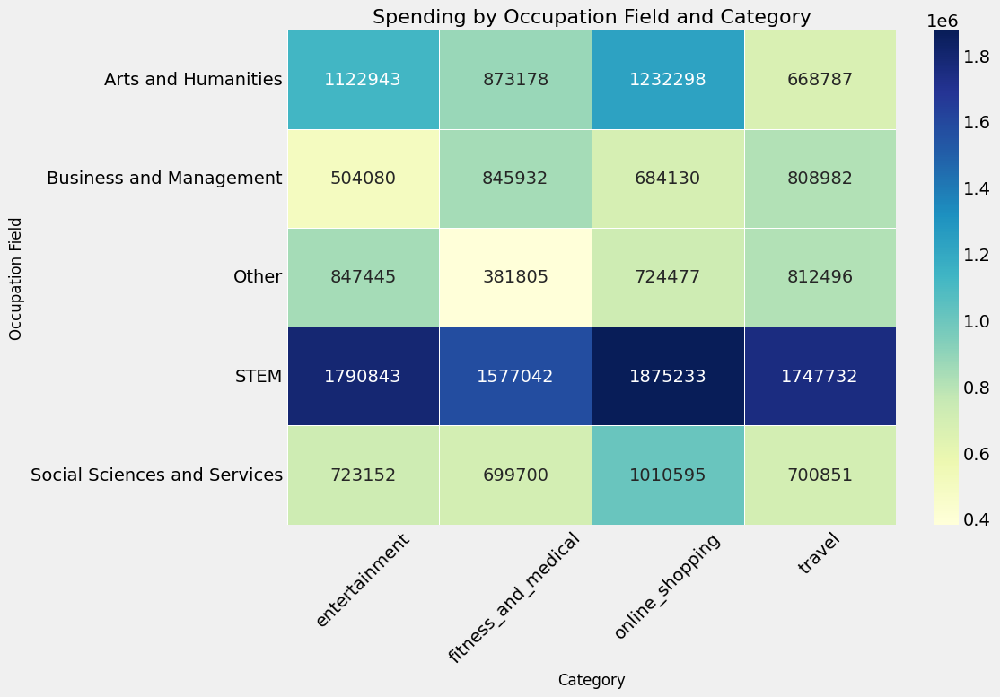

In [ ]:
# Create a copy of the relevant data to avoid modifying the original df
analysis_df = df[['Occupation Field', 'category', 'amt']].copy()

# Group by Occupation Field and Category, then sum the spending
occupation_category_spending = analysis_df.groupby(['Occupation Field', 'category'])['amt'].sum().reset_index()

# Pivot the data to create a clear summary
pivot_data = occupation_category_spending.pivot(index='Occupation Field', columns='category', values='amt').fillna(0)

# Display the result (does not modify the original df)
print(pivot_data)

# Save the result to a CSV file
pivot_data.to_csv('Occupation_vs_Category_Spending.csv')

# Visualization: Heatmap
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 8))
sns.heatmap(pivot_data, annot=True, fmt=".0f", cmap="YlGnBu", linewidths=0.5)
plt.title('Spending by Occupation Field and Category', fontsize=16)
plt.xlabel('Category', fontsize=12)
plt.ylabel('Occupation Field', fontsize=12)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


In [ ]:
# Filter rows where Occupation Field is 'Others'
others_jobs = df[df['Occupation Field'] == 'Other']['job']  # Replace 'Job Title' with the actual column name for job titles

# Get unique job titles under 'Others'
unique_others_jobs = others_jobs.unique()

# Count the number of unique jobs
num_unique_others_jobs = len(unique_others_jobs)

# Display the results
print("Jobs under 'Other' category:")
print(unique_others_jobs)
print(f"\nTotal number of unique jobs under 'Other': {num_unique_others_jobs}")


Jobs under 'Other' category:
['Land' 'Forensic psychologist' 'Clinical psychologist'
 "Politician's assistant" 'Gaffer' 'Multimedia specialist' 'Risk analyst'
 'Merchandiser, retail' 'Psychologist, occupational'
 'Television camera operator' 'Publishing copy' 'Chartered loss adjuster'
 'Financial adviser' 'Patent attorney' 'Environmental health practitioner'
 'Pathologist' 'Retail merchandiser' 'Insurance risk surveyor'
 'Occupational psychologist' 'Radiographer, diagnostic' 'Lexicographer'
 'Camera operator' 'Claims inspector-assessor' 'Financial risk analyst'
 'Associate Professor' 'Psychologist, educational'
 'Air traffic controller' 'IT trainer' 'Buyer, industrial'
 'Surveyor, quantity' 'Translator' 'Ranger-warden' 'Airline pilot'
 'Visual merchandiser' 'Freight forwarder'
 'Commercial-residential surveyor' 'Production assistant, television'
 'Psychologist, clinical' 'Counselling psychologist'
 'Educational psychologist' 'Dealer' 'Make' 'Civil Service fast streamer'
 'Psychologist,

THE END